# **cali_house_prices Data Analysis Notebook**

## Objectives

* In this notebook, we will fetch the data california_housing_price from Kaggle. 
- We will explore the raw data
- we will clean it, 
- fill the missing values, 
- check the distributions and descriptive statistics
- removing outliers. 
- We will plot them with Seaborn and Plotly plots 
- And finally export it as a clean dataset for a Power BI dashboard.

## Inputs

* houing.csv dataset imported from kaggle using API

## Outputs

* df_clean, Ydata_EDA_report.html, ML model file named ML_model.pki, and plotly file named california_housing_treemap.html

## Additional Comments

* If you have any additional comments that don't fit in the previous bullets, please state them here. 



### import necessary libraries for data analysis

First we wimport the libraries we need for data analysis

In [ ]:
# import necessary libraries for data analysis and machine learning

import os
import glob
import zipfile
import shutil
import math
import itertools


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import pingouin as pg
%matplotlib inline

import plotly.express as px
import plotly.io as pio
from scipy import stats
from numpy.random import normal

import joblib
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler  
from sklearn.model_selection import train_test_split, cross_val_score
from feature_engine.imputation import MeanMedianImputer
from feature_engine.selection import DropFeatures
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import GridSearchCV

# ML algorithms 
from sklearn.ensemble import AdaBoostRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor

import warnings
warnings.filterwarnings("ignore")

sns.set_style("whitegrid")

## ETL

### Extraction
We will load the dataset from Kaggle through API.But before that we need to see our directory structure
and current directoy.

In [2]:

# Get the current working directory and assign it to current_dir
current_dir = os.getcwd()
current_dir


'c:\\Users\\Ali\\Downloads\\from reset\\Other temps\\Code Institute\\Course\\DA\\California_House_Prices\\jupyter_notebooks'

Now we change the current diretory one level up where our kaggle API file is located

In [3]:
# Change the current working directory to its parent directory
os.chdir(os.path.dirname(current_dir))
print("You set a new current directory")

# Update and display the new current working directory
current_dir = os.getcwd()
current_dir

You set a new current directory


'c:\\Users\\Ali\\Downloads\\from reset\\Other temps\\Code Institute\\Course\\DA\\California_House_Prices'

In [ ]:
# Set the Kaggle API configuration directory to the current working directory
os.environ['KAGGLE_CONFIG_DIR'] = os.getcwd()

In [ ]:
# Define the Kaggle dataset path and the destination folder for the downloaded data
KaggleDatasetPath = "camnugent/california-housing-prices"
DestinationFolder = "inputs/datasets/raw"

Now we download from Kaggle 

In [ ]:
# Download the dataset from Kaggle using the specified dataset path and destination folder
! kaggle datasets download -d {KaggleDatasetPath} -p {DestinationFolder}

Dataset URL: https://www.kaggle.com/datasets/camnugent/california-housing-prices
License(s): CC0-1.0




  0%|          | 0.00/400k [00:00<?, ?B/s]
100%|██████████| 400k/400k [00:00<00:00, 137MB/s]


Since the dataset file is in zop format we will unzip it using the following code

In [ ]:
# Find all zip files in the destination folder
zip_files = glob.glob(os.path.join(DestinationFolder, "*.zip"))
print(zip_files)

# Loop through each zip file, extract its contents, and remove the zip file
for zip_file in zip_files:
    print('zip_file')
    with zipfile.ZipFile(zip_file, 'r') as zip_ref:
        zip_ref.extractall(DestinationFolder)  # Extract here
    os.remove(zip_file)  # Remove the ZIP file after extraction

print("Extraction complete.")

['inputs/datasets/raw\\california-housing-prices.zip']
zip_file
Extraction complete.


##### Now our file is downloaded, we will load dataframe in df and quickly check its top content

In [ ]:
# Load the California housing dataset into a DataFrame from the specified destination folder
df = pd.read_csv(f'{DestinationFolder}/housing.csv')
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


## EDA (Exploratory Data Ananlyis)

First we will check how many columns and rows the data has 

In [12]:
# Display the shape of the dataframe (number of rows, number of columns)
df.shape

(20640, 10)

Now we check the last five rows of the dataset.

In [ ]:
# Displays the last five rows of the dataframe to inspect the data at the end of the dataset
df.tail()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND
20639,-121.24,39.37,16.0,2785.0,616.0,1387.0,530.0,2.3886,89400.0,INLAND


#### Ydata Profiling:

For exploratory data analysis, we will use YDataProfiling, which will give a summary of all variables, their behaviors, distributions in the dataset.

In [13]:
# Generate a minimal profiling report for the dataframe using ydata_profiling
from ydata_profiling import ProfileReport
profile = ProfileReport(df=df, minimal=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 10/10 [00:00<00:00, 27.76it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Export Ydata Report:
Now we export this report from original dataframe to a output directory.

In [ ]:
# Export the YData Profiling report to an HTML file for further review or sharing
profile.to_file(output_file='outputs/datasets/cleaned/Ydata_EDA_report.html') 

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

From YData report we can see there are some missing values and outliers in different variables and distributions but we want to explore manually again the dataset in orer to confirm report from ydata_profiling

In [15]:
# Display concise summary of the DataFrame, including column names, non-null counts, and data types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


Now will check for missing values in data frame

In [16]:
# Check for missing values in each column of the dataframe
df.isnull().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

No we want to check the data types of each column in the dataframe

In [ ]:
# Displays the data types of each column in the dataframe
df.dtypes

longitude             float64
latitude              float64
housing_median_age    float64
total_rooms           float64
total_bedrooms        float64
population            float64
households            float64
median_income         float64
median_house_value    float64
ocean_proximity        object
dtype: object

Now we want to see full descriptive statistics of our data frame


In [18]:
# Display descriptive statistics for all columns in the dataframe, including numeric and categorical data
df.describe(include='all')

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,<1H OCEAN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9136
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909,NaN
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874,NaN
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000,NaN
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000,NaN
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000,NaN
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000,NaN


Since we could not see the skewness and kurtosis in previous cell so we include Skewness and Kurtosis as well in describe


In [19]:
# Select only numeric columns
numeric_df = df.select_dtypes(include='number')

# Compute skewness and kurtosis
ser_skew = numeric_df.skew()
ser_skew.name = 'Skewness'

ser_kurt = numeric_df.kurtosis()
ser_kurt.name = 'Kurtosis'

# Get descriptive statistics
summary_stats = numeric_df.describe()

# Combine all rows into one DataFrame using concat
summary_stats = pd.concat([summary_stats, pd.DataFrame([ser_skew]), pd.DataFrame([ser_kurt])])

summary_stats

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000
Skewness,-0.297801,0.465953,0.060331,4.147343,3.459546,4.935858,3.410438,1.646657,0.977763
Kurtosis,-1.330152,-1.117760,-0.800629,32.630927,21.985575,73.553116,22.057988,4.952524,0.327870


#### Duplicate rows
We will check for duplicate rows

In [20]:
# Find and display all duplicate rows in the dataframe
duplicates = df[df.duplicated()]
duplicates

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity


We will confirm again if there are any duplicates 


In [21]:
# Count the number of duplicate rows in the dataframe
df.duplicated().sum()

0

#### Unique Values
We will check how many and what unique values are in categorical variable


In [22]:
# Display what unique values are in categorical column 'ocean_proximity'
df['ocean_proximity'].unique()

array(['NEAR BAY', '<1H OCEAN', 'INLAND', 'NEAR OCEAN', 'ISLAND'],
      dtype=object)

Now we will see how many there are in numbers and plot them

ocean_proximity
<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: count, dtype: int64
ocean_proximity
<1H OCEAN     0.442636
INLAND        0.317393
NEAR OCEAN    0.128779
NEAR BAY      0.110950
ISLAND        0.000242
Name: proportion, dtype: float64


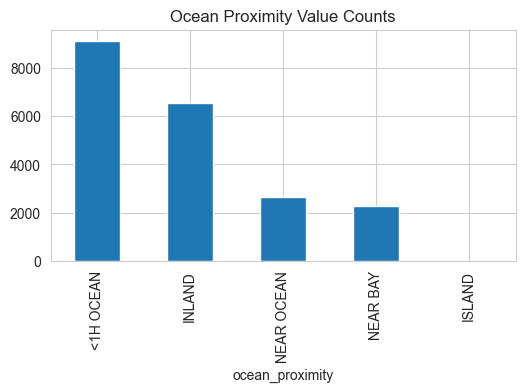

In [24]:
#display how many unique values are in categorical column 'ocean_proximity'
print(df['ocean_proximity'].value_counts())

#display unique values are in categorical column 'ocean_proximity' as a percentage
print(df['ocean_proximity'].value_counts(normalize=True))  

# Display the value counts of 'ocean_proximity' as a bar plot
df['ocean_proximity'].value_counts().plot(kind='bar', figsize=(6,3), title='Ocean Proximity Value Counts') 
plt.show()

#### Outliers checking in all variables


##### To check the outliers we will plot them in scatter and box plot and loop through all columns once again

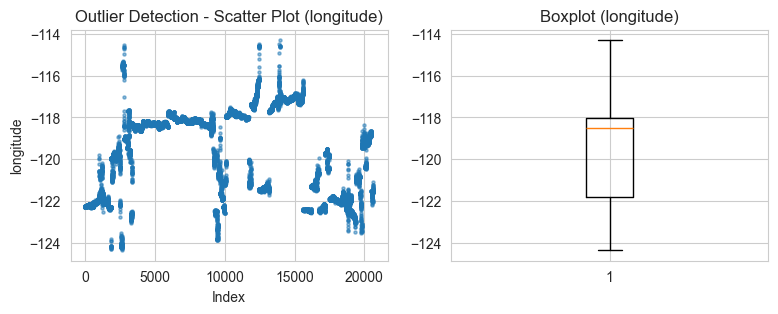

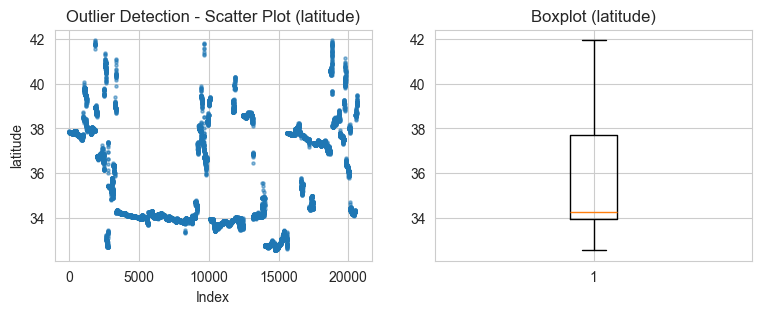

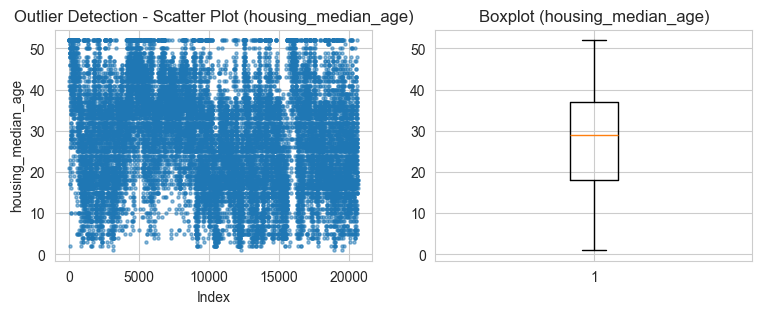

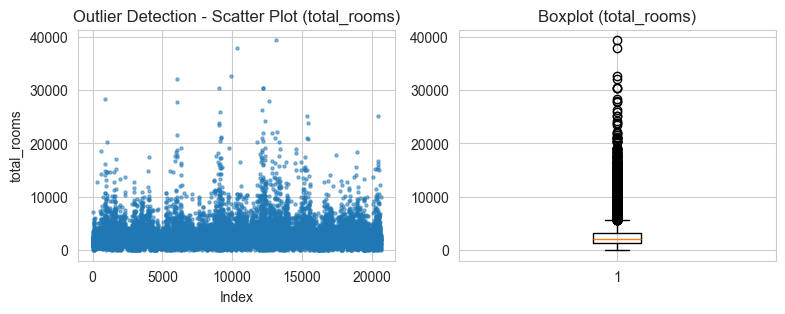

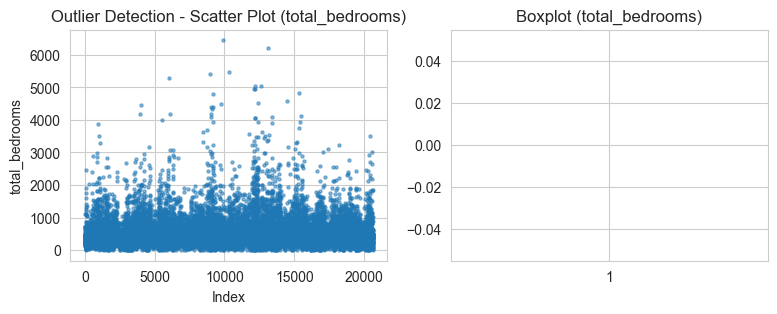

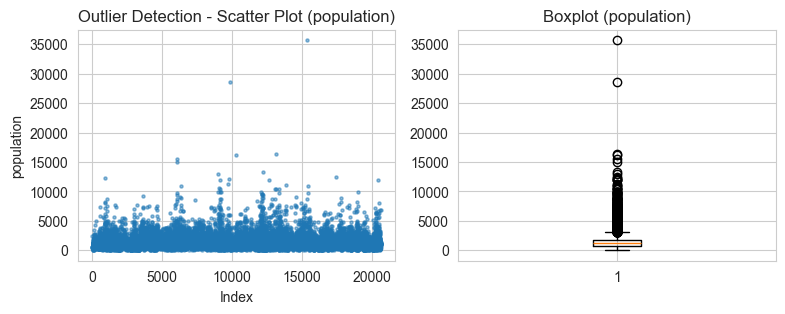

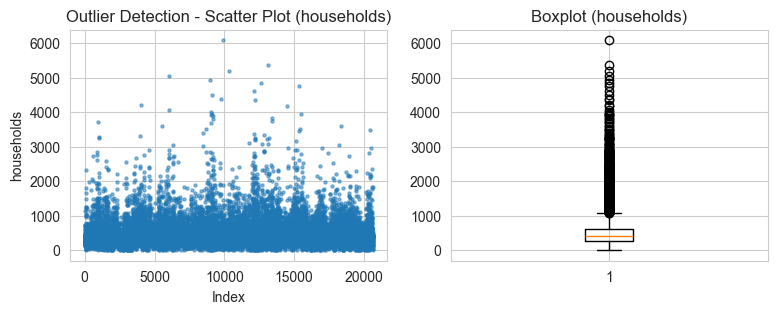

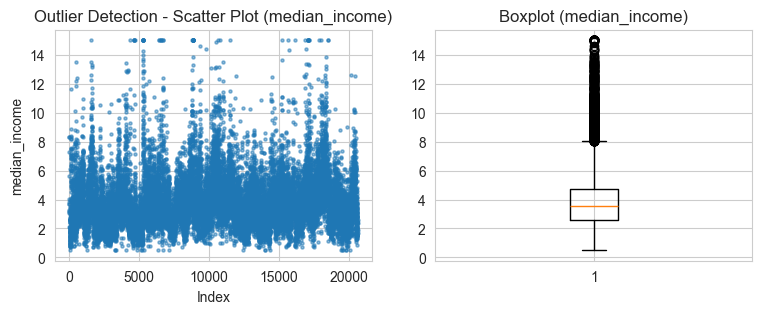

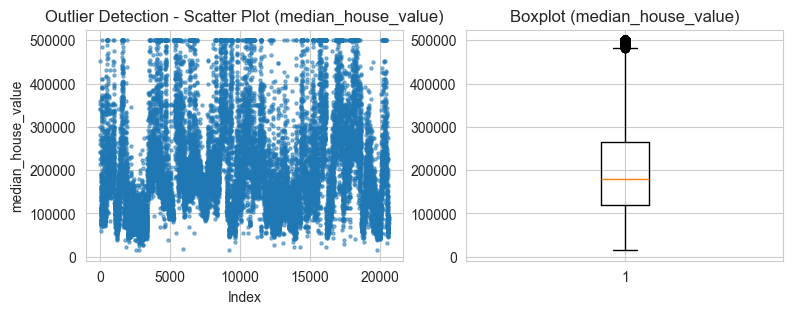

In [25]:

# To see the outliers, loop through each numerical column and plot both scatter & boxplot side by side
for col in df.select_dtypes(include=["number"]).columns:
    fig, axes = plt.subplots(1, 2, figsize=(9, 3))  # 1 row, 2 columns layout

    # Scatter Plot
    axes[0].scatter(df.index, df[col], alpha=0.5, s=5)
    axes[0].set_xlabel("Index")
    axes[0].set_ylabel(col)
    axes[0].set_title(f"Outlier Detection - Scatter Plot ({col})")

    # Box Plot
    axes[1].boxplot(df[col])
    axes[1].set_title(f"Boxplot ({col})")

    plt.show()

We can see that there are some potential outliers in population, households, total_rooms, and total_bedrooms, but we keep them now and handle them later

## Transformation

Before we do any transformation we copy the origianl data frame to clean dataframe variable df_clean to transform
and we will check the shape and its structure.

In [26]:
# Create a copy of the original dataframe for cleaning and transformation
df_clean = df.copy()

# Display the shape of the new dataframe
print(df_clean.shape)

# Show the first few rows to verify the copy
df_clean.head()

(20640, 10)


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


Once again we will check for missing and null values in new datafram

In [27]:
# Check for missing values in each column of the cleaned dataframe
df_clean.isnull().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

#### Filling missing values:
There are 207 missing values in total_bedrooms we will fill them with median values and we will check again the shape of data frame and for missing values

In [28]:
# Fill missing values in 'total_bedrooms' column with the median value
df_clean['total_bedrooms'].fillna(df_clean['total_bedrooms'].median(), inplace=True)

# Print the shape of the cleaned dataframe
print(df_clean.shape)

# Check for any remaining missing values in the dataframe
df_clean.isnull().sum()

(20640, 10)


longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
ocean_proximity       0
dtype: int64

When we were looping through columns we noticed potetintail outliers in population, households, total_rooms, and total_bedrooms.

First we will check the population column for miniumum, median and maximum values.

In [29]:
# Display the maximum, median, and minimum values of the 'population' column in the cleaned dataframe
print(f"maximum: {df_clean['population'].max()}")
print(f"median: {df_clean['population'].median()}")
print(f"minimum: {df_clean['population'].min()}")



maximum: 35682.0
median: 1166.0
minimum: 3.0


The maximum vakue is quite far from median so now we will see the 10 maximum values in dataframe to identify how many potential outliers could be there

In [30]:
# Display the top 10 rows with the highest population values in the cleaned dataframe
df_clean['population'].sort_values(ascending=False).head(10)

15360    35682.0
9880     28566.0
13139    16305.0
10309    16122.0
6057     15507.0
6066     15037.0
12215    13251.0
9019     12873.0
17413    12427.0
922      12203.0
Name: population, dtype: float64

We will plot them again in scatter plot just to visialise


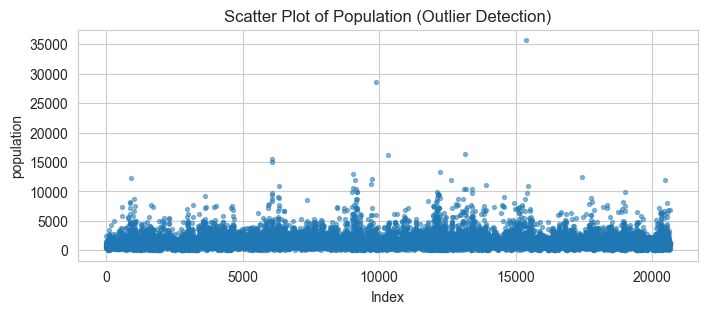

In [31]:
# Plot a scatter plot to visualize potential outliers in the 'population' column of the cleaned dataframe
plt.figure(figsize=(8, 3))
plt.scatter(df_clean.index, df_clean['population'], alpha=0.5, s=8)
plt.title("Scatter Plot of Population (Outlier Detection)")
plt.xlabel("Index")
plt.ylabel("population")
plt.show()

#### Outliers removal

So we noticed 2 potential outliers in scatter plot and in dataframe which are really far from other data points in dataset of more than 20,000 rows.
So we will remove these 2 outliers

In [32]:
# Remove two specific outlier rows from df_clean where population is 35682.0 or 28566.0
df_clean = df_clean.query("population != 35682.0 and population != 28566.0")

Now we will plot again in order to check:

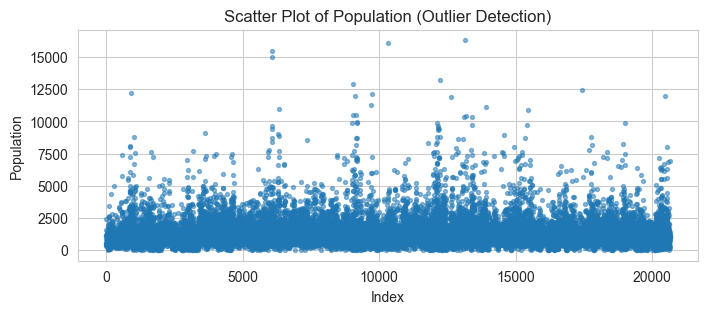

In [33]:
# Plot a scatter plot to visualize the 'population' column after outlier removal
plt.figure(figsize=(8, 3))
plt.scatter(df_clean.index, df_clean['population'], alpha=0.5, s=8)
plt.title("Scatter Plot of Population (Outlier Detection)")
plt.xlabel("Index")
plt.ylabel("Population")
plt.show()

Now we check other 2 variables with potential outliers total_rooms, population and total_bedrooms.

First we see the top 10 maximum values in dataframe then we plot them as before.

First we see the total_rooms

In [34]:
# Display the top 10 rows with the highest values in the 'total_rooms' column of the cleaned dataframe
df_clean['total_rooms'].sort_values(ascending=False).head(10)

13139    39320.0
10309    37937.0
6057     32054.0
12201    30450.0
9019     30405.0
12215    30401.0
922      28258.0
12623    27870.0
6066     27700.0
12152    26322.0
Name: total_rooms, dtype: float64

Now we will plot total_rooms

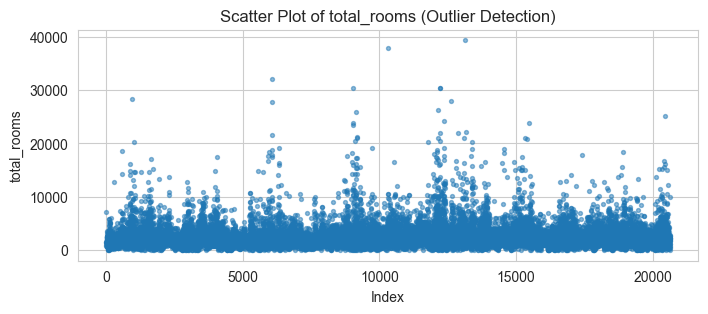

In [35]:
# Plot a scatter plot to visualize potential outliers in the 'total_rooms' column of the cleaned dataframe
plt.figure(figsize=(8, 3))
plt.scatter(df_clean.index, df_clean['total_rooms'], alpha=0.5, s=8)
plt.title("Scatter Plot of total_rooms (Outlier Detection)")
plt.xlabel("Index")
plt.ylabel("total_rooms")
plt.show()

Now we will check the maximumm values of total_bedrooms and plot them

In [36]:
# Display the top 10 rows with the highest values in the 'total_bedrooms' column of the cleaned dataframe
df_clean['total_bedrooms'].sort_values(ascending=False).head(10)

13139    6210.0
10309    5471.0
8985     5419.0
6057     5290.0
12201    5033.0
12623    5027.0
12215    4957.0
12106    4952.0
9145     4798.0
14505    4585.0
Name: total_bedrooms, dtype: float64

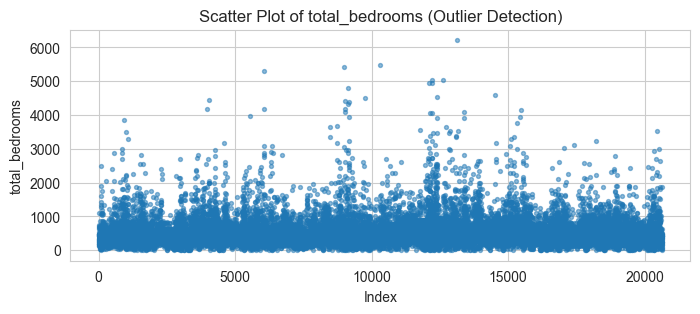

In [37]:
# Plot a scatter plot to visualize potential outliers in the 'total_bedrooms' column of the cleaned dataframe
plt.figure(figsize=(8, 3))
plt.scatter(df_clean.index, df_clean['total_bedrooms'], alpha=0.5, s=8)
plt.title("Scatter Plot of total_bedrooms (Outlier Detection)")
plt.xlabel("Index")
plt.ylabel("total_bedrooms")
plt.show()

Now we will check the maximumm values of households and plot them


In [38]:
# Display the top 10 rows with the highest values in the 'households' column of the cleaned dataframe
df_clean['households'].sort_values(ascending=False).head(10)

13139    5358.0
10309    5189.0
6057     5050.0
8985     4930.0
12623    4855.0
12106    4616.0
9145     4490.0
9744     4372.0
12215    4339.0
4035     4204.0
Name: households, dtype: float64

In 3 variables total_rooms, total_bedrooms and households, there could be 1 or 2 outliers but we will keep them for dashboard 
visualization purposes in Power BI. We dont want to disturb original dataset where the maximum values don't seem to be very far

### Feature Engineering:

##### First we will rename the columns for Power BI readability and for non-technical person
We will rename 9 columns out of 10


In [39]:
# Rename columns for Power BI readability
df_clean.rename(columns={
    "longitude": "Longitude",
    "latitude": "Latitude",
    "housing_median_age": "Housing Age",
    "total_rooms": "Total Rooms",
    "total_bedrooms": "Total Bedrooms",
    "population": "Population",
    "households": "Households",
    "median_income": "Median Income",
    "median_house_value": "Median House Value"
}, inplace=True)

We will check again the shape and dataframe itself for the change of names

In [40]:
# Display the shape of the cleaned dataframe and show the first few rows to verify column renaming and data integrity
print(df_clean.shape)
df_clean.head()

(20638, 10)


,Longitude,Latitude,Housing Age,Total Rooms,Total Bedrooms,Population,Households,Median Income,Median House Value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


#### Descriptive Statistics:

#### Correlation Matrix of all numerical variables

First we create the correlation matrix of all varaiables to see correlation

In [41]:
# checking correlation between numeric columns, method is pearson
df_numeric = df_clean.select_dtypes(include=['number'])

# Compute the correlation matrix for the numeric columns
correlation_matrix = df_clean.select_dtypes(include=['number']).corr()

# Display the correlation matrix
correlation_matrix

,Longitude,Latitude,Housing Age,Total Rooms,Total Bedrooms,Population,Households,Median Income,Median House Value
Longitude,1.000000,-0.924667,-0.108227,0.045096,0.069864,0.103290,0.055977,-0.015186,-0.045979
Latitude,-0.924667,1.000000,0.011146,-0.036141,-0.066771,-0.111884,-0.071380,-0.079831,-0.144184
Housing Age,-0.108227,0.011146,1.000000,-0.362379,-0.319874,-0.304115,-0.303817,-0.119141,0.105547
Total Rooms,0.045096,-0.036141,-0.362379,1.000000,0.925989,0.863773,0.917251,0.200383,0.135955
Total Bedrooms,0.069864,-0.066771,-0.319874,0.925989,1.000000,0.880835,0.973992,-0.006768,0.050663
Population,0.103290,-0.111884,-0.304115,0.863773,0.880835,1.000000,0.914769,0.007050,-0.023716
Households,0.055977,-0.071380,-0.303817,0.917251,0.973992,0.914769,1.000000,0.014101,0.067277
Median Income,-0.015186,-0.079831,-0.119141,0.200383,-0.006768,0.007050,0.014101,1.000000,0.688059
Median House Value,-0.045979,-0.144184,0.105547,0.135955,0.050663,-0.023716,0.067277,0.688059,1.000000


#### HeatMap

Now we plot heatmap of correlation matrix of numerical variables

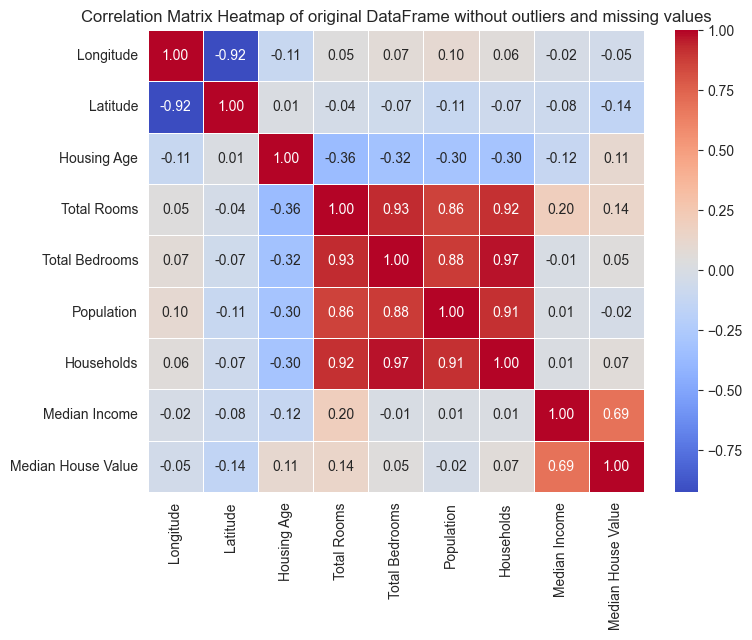

Explanation:
- 'Median Income' has a strong positive correlation (0.69) with 'Median House Value', indicating that higher income areas tend to have higher house values.
- 'Total Rooms', 'Total Bedrooms', and 'Households' are highly correlated with each other (>0.9), as expected due to their related nature.
- 'Longitude' and 'Latitude' are negatively correlated, reflecting the geographic layout of California.
- Most other variables show weak to moderate correlations with 'Median House Value'.

Conclusion:
The strongest predictor of house value in this dataset is 'Median Income'. Other features like room counts and population are interrelated, so care should be taken to avoid multicollinearity in modeling.


In [42]:
# Heatmap of the correlation matrix
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix Heatmap of original DataFrame without outliers and missing values")
plt.show()

# Explanation and conclusion
print(
    "Explanation:\n"
    "- 'Median Income' has a strong positive correlation (0.69) with 'Median House Value', indicating that higher income areas tend to have higher house values.\n"
    "- 'Total Rooms', 'Total Bedrooms', and 'Households' are highly correlated with each other (>0.9), as expected due to their related nature.\n"
    "- 'Longitude' and 'Latitude' are negatively correlated, reflecting the geographic layout of California.\n"
    "- Most other variables show weak to moderate correlations with 'Median House Value'.\n"
    "\nConclusion:\n"
    "The strongest predictor of house value in this dataset is 'Median Income'. Other features like room counts and population are interrelated, so care should be taken to avoid multicollinearity in modeling."
)

Now we will see mean, median mode, standard deviation, amount of skewness through plotting distributions

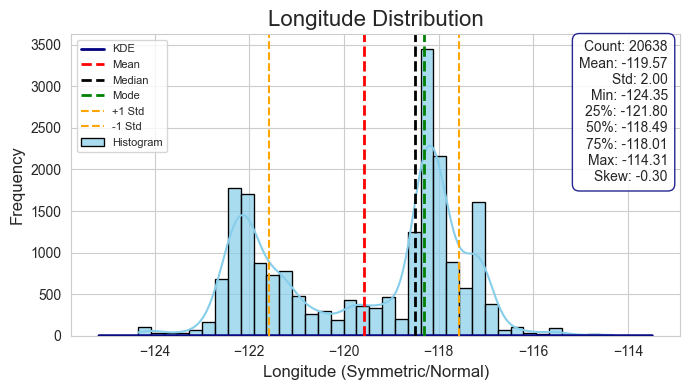

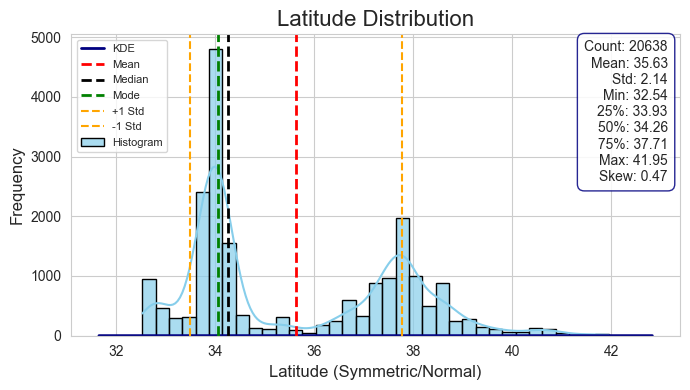

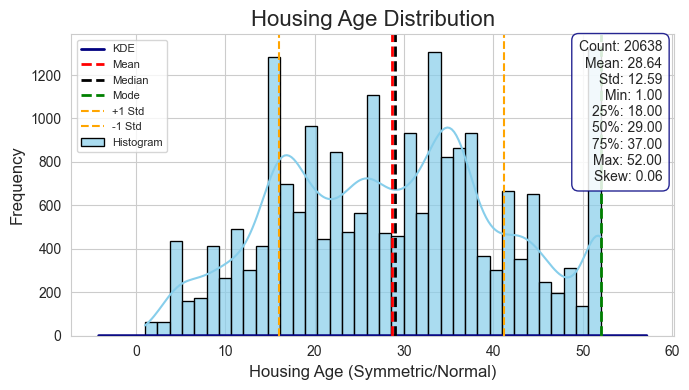

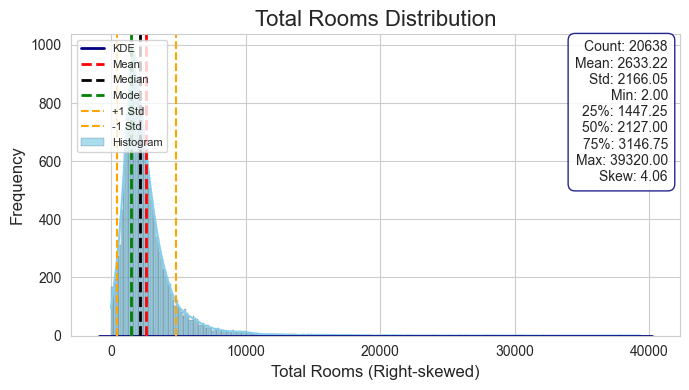

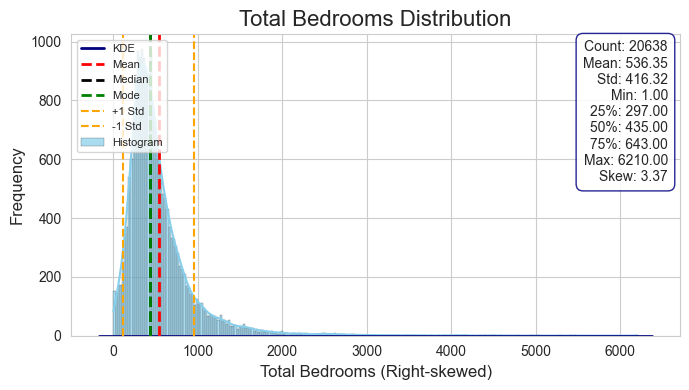

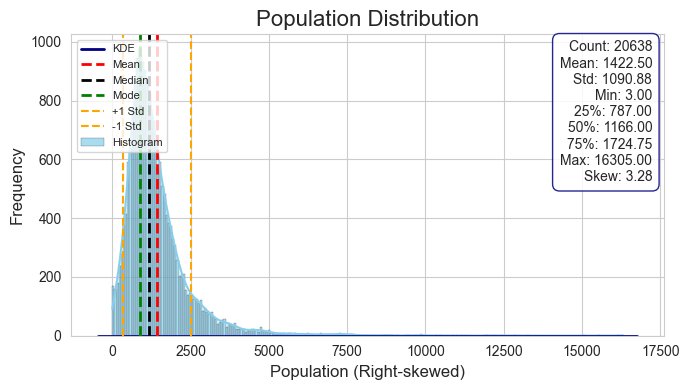

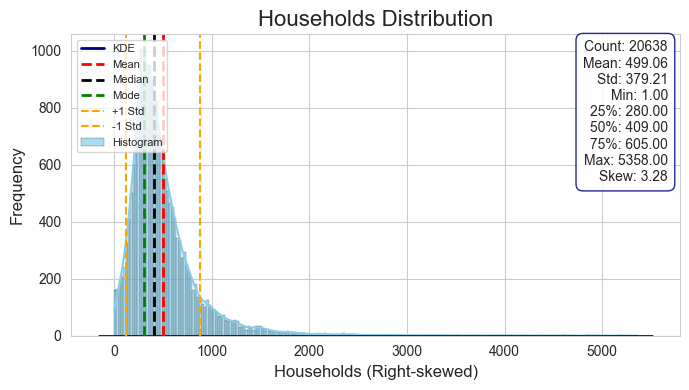

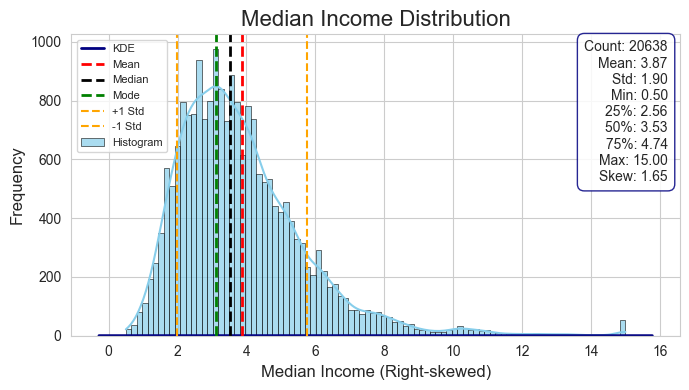

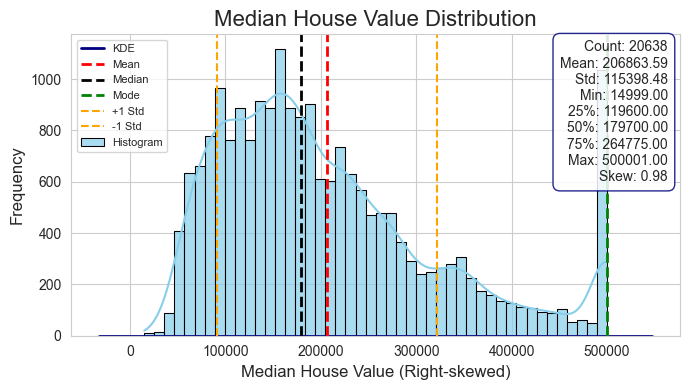

In [43]:
# For each numeric column in df_clean, plot its distribution with histogram and KDE,
# and annotate with mean, median, mode, standard deviation, and skewness.
for col in df_clean.columns:
    if pd.api.types.is_numeric_dtype(df_clean[col]):
        plt.figure(figsize=(7, 4))
        plt.title(f"{col} Distribution", fontsize=16)
        # Histogram in light blue, KDE in navy
        ax = sns.histplot(df_clean[col], kde=True, color="skyblue", alpha=0.7, edgecolor="black", label="Histogram")
        sns.kdeplot(df_clean[col], color="navy", linewidth=2, ax=ax, label="KDE")

        mean_val = df_clean[col].mean(skipna=True)
        median_val = df_clean[col].median(skipna=True)
        mode_val = df_clean[col].mode(dropna=True).iloc[0] if not df_clean[col].mode().empty else np.nan
        std_val = df_clean[col].std(skipna=True)
        skewness = df_clean[col].skew(skipna=True)

        # Add vertical lines for mean, median, mode, and ±1 std
        plt.axvline(mean_val, color='red', linestyle='dashed', linewidth=2, label="Mean")
        plt.axvline(median_val, color='black', linestyle='dashed', linewidth=2, label="Median")
        plt.axvline(mode_val, color='green', linestyle='dashed', linewidth=2, label="Mode")
        plt.axvline(mean_val + std_val, color='orange', linestyle='dashed', linewidth=1.5, label="+1 Std")
        plt.axvline(mean_val - std_val, color='orange', linestyle='dashed', linewidth=1.5, label="-1 Std")

        # Prepare descriptive statistics text box
        desc = df_clean[col].describe()
        description = (
            f"Count: {desc['count']:.0f}\n"
            f"Mean: {desc['mean']:.2f}\n"
            f"Std: {desc['std']:.2f}\n"
            f"Min: {desc['min']:.2f}\n"
            f"25%: {desc['25%']:.2f}\n"
            f"50%: {desc['50%']:.2f}\n"
            f"75%: {desc['75%']:.2f}\n"
            f"Max: {desc['max']:.2f}\n"
            f"Skew: {skewness:.2f}"
        )
        # Place description box at top right
        plt.gca().text(
            0.98, 0.98, description, transform=plt.gca().transAxes,
            fontsize=10, verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle="round,pad=0.5", fc="white", ec="navy", lw=1, alpha=0.85)
        )

        # Determine distribution type based on skewness
        if abs(skewness) < 0.5:
            dist_type = "Symmetric/Normal"
        elif skewness > 0.5:
            dist_type = "Right-skewed"
        else:
            dist_type = "Left-skewed"
        plt.xlabel(f"{col} ({dist_type})", fontsize=12)
        plt.ylabel("Frequency", fontsize=12)
        # Show legend in top left
        plt.legend(loc='upper left', fontsize=8, frameon=True)
        plt.tight_layout()
        plt.show()

##### Now we will check Kurtosis in all variables through histogram and kde plots

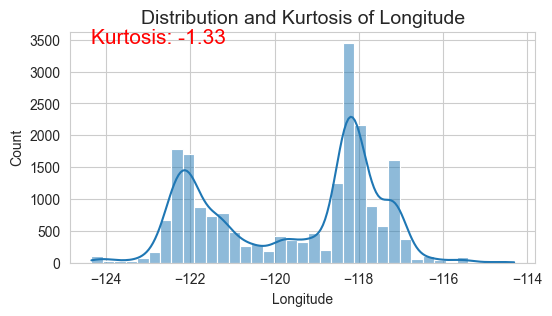

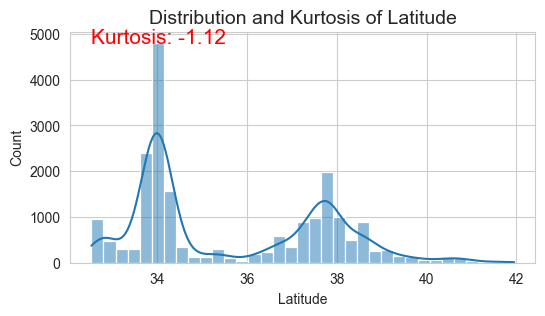

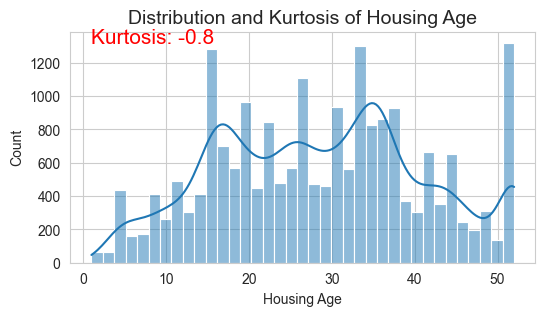

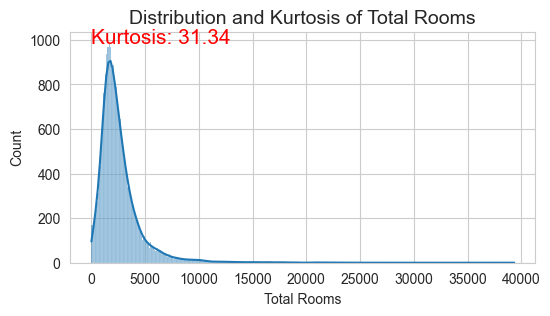

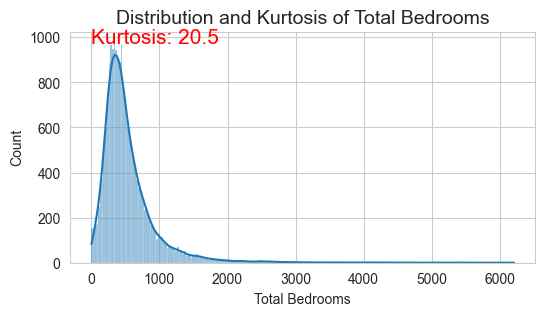

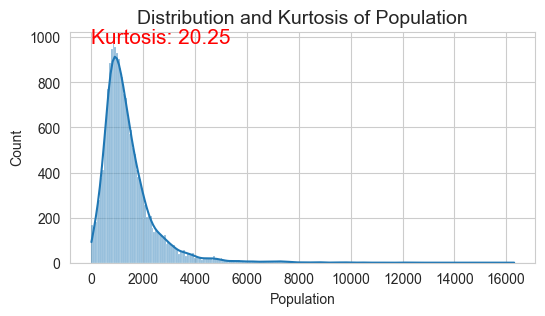

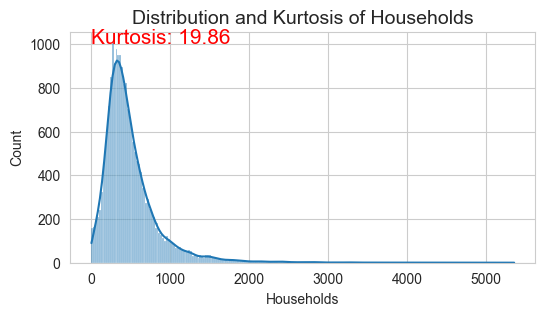

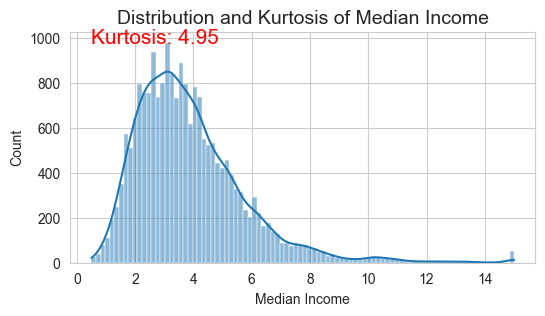

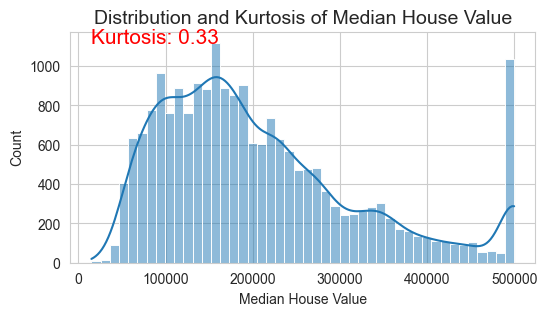

In [44]:
# Plot the distribution and kurtosis for each column in df_clean except 'ocean_proximity'
for col in df_clean.columns:
  if col != 'ocean_proximity':
    fig, axes = plt.subplots(figsize=(6, 3))
    
    # Plot histogram and KDE for the column
    sns.histplot(data=df_clean, x=col, kde=True)
    plt.title(f"Distribution and Kurtosis of {col}", fontsize=14)
    
    # Display kurtosis value on the plot
    plt.text(
      x=df_clean[col].min(),
      y=axes.get_ylim()[1] * 0.95,
      s=f"Kurtosis: {df_clean[col].kurtosis().round(2)}",
      fontsize=15,
      c='r'
    )
    plt.show()

We will also plot Quantile-Quantile plot to compare the distribution of all variables that if the points lie roughly on the straight line, then data is likely normally distributed.

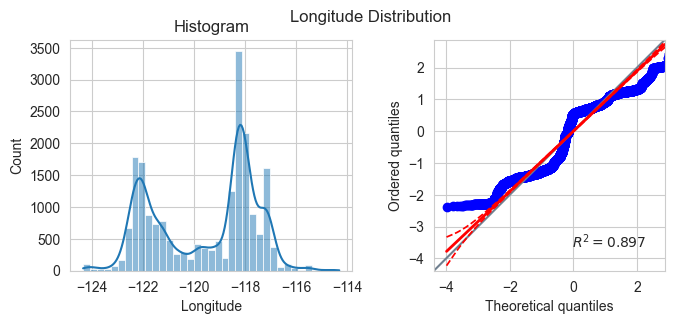

Longitude: The distribution is approximately symmetric with a kurtosis of -1.33 (platykurtic (light tails, fewer outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



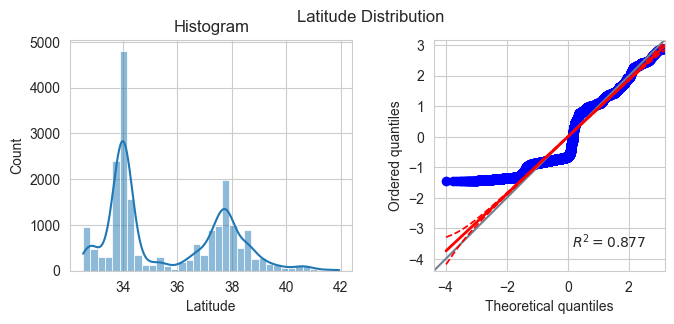

Latitude: The distribution is approximately symmetric with a kurtosis of -1.12 (platykurtic (light tails, fewer outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



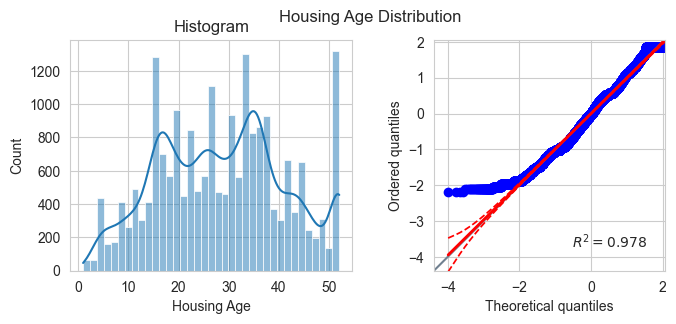

Housing Age: The distribution is approximately symmetric with a kurtosis of -0.80 (platykurtic (light tails, fewer outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



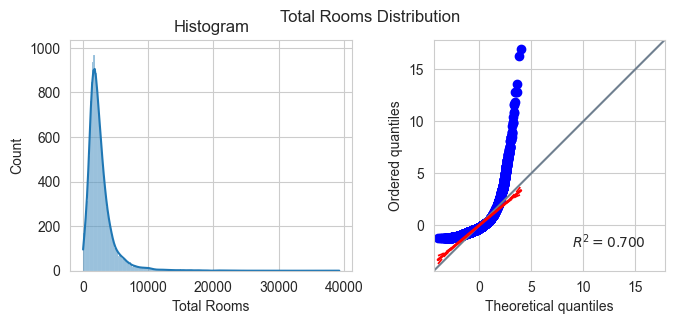

Total Rooms: The distribution is right-skewed (long tail to the right) with a kurtosis of 31.34 (leptokurtic (heavy tails, more outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



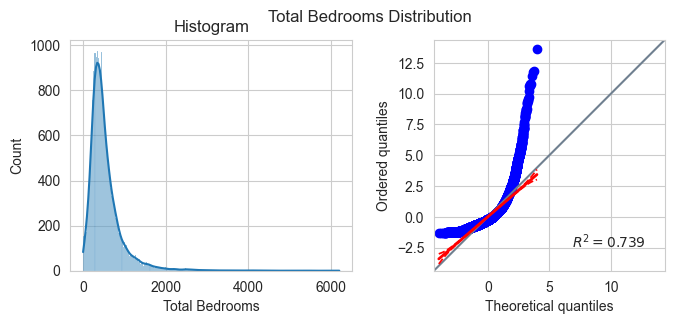

Total Bedrooms: The distribution is right-skewed (long tail to the right) with a kurtosis of 20.50 (leptokurtic (heavy tails, more outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



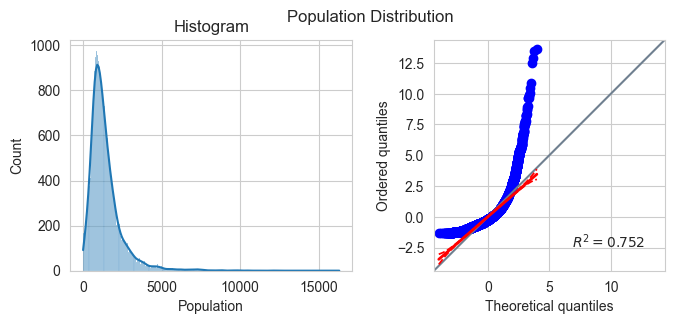

Population: The distribution is right-skewed (long tail to the right) with a kurtosis of 20.25 (leptokurtic (heavy tails, more outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



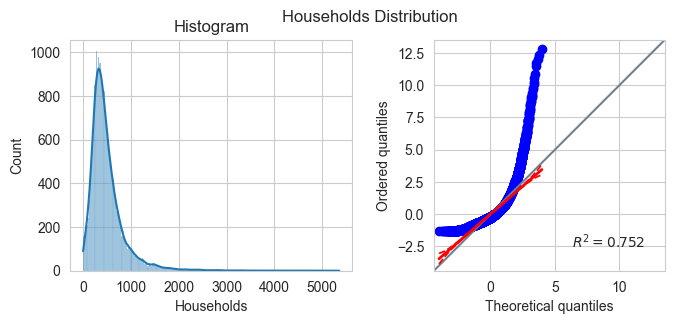

Households: The distribution is right-skewed (long tail to the right) with a kurtosis of 19.86 (leptokurtic (heavy tails, more outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



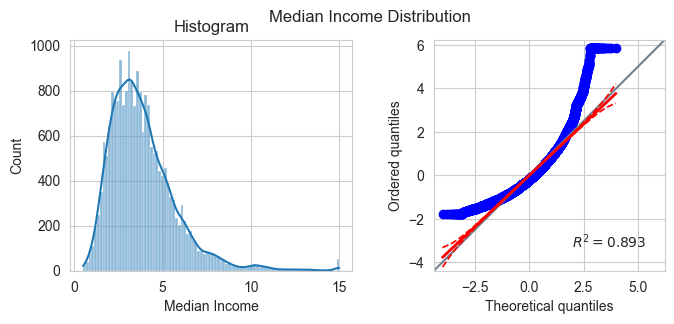

Median Income: The distribution is right-skewed (long tail to the right) with a kurtosis of 4.95 (leptokurtic (heavy tails, more outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



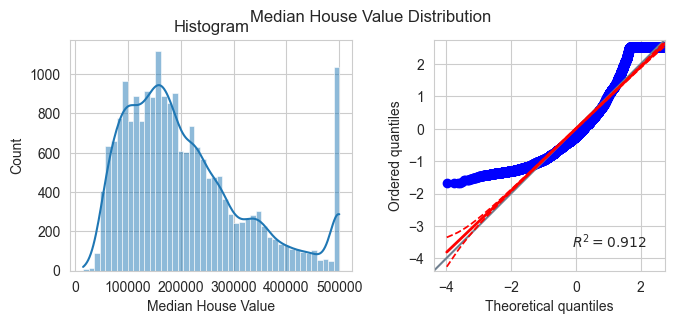

Median House Value: The distribution is right-skewed (long tail to the right) with a kurtosis of 0.33 (platykurtic (light tails, fewer outliers)).
The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.



In [46]:
# For each numeric column in df_clean, plot both a histogram (with KDE) and a Q-Q plot to assess normality.
# Then, print a summary of skewness and kurtosis for interpretation.

for col in df_clean.select_dtypes(include='number').columns:
  fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 3))
  
  # Plot histogram with KDE
  sns.histplot(data=df_clean, x=col, kde=True, ax=axes[0])
  axes[0].set_title("Histogram")
  
  # Q-Q plot against normal distribution
  pg.qqplot(df_clean[col], dist='norm', ax=axes[1])
  fig.suptitle(f"{col} Distribution")
  plt.show()
  
  # Calculate skewness and kurtosis
  skew = df_clean[col].skew()
  kurt = df_clean[col].kurtosis()
  
  # Interpret skewness
  if abs(skew) < 0.5:
    skew_desc = "approximately symmetric"
  elif skew > 0.5:
    skew_desc = "right-skewed (long tail to the right)"
  else:
    skew_desc = "left-skewed (long tail to the left)"
  
  # Interpret kurtosis
  if kurt > 3:
    kurt_desc = "leptokurtic (heavy tails, more outliers)"
  elif kurt < 3:
    kurt_desc = "platykurtic (light tails, fewer outliers)"
  else:
    kurt_desc = "mesokurtic (normal tails)"
  
  # Print interpretation
  print(f"{col}: The distribution is {skew_desc} with a kurtosis of {kurt:.2f} ({kurt_desc}).")
  print("The histogram shows the frequency and shape of the data, while the Q-Q plot compares it to a normal distribution. Deviations from the straight line in the Q-Q plot indicate departures from normality.\n")


##### WE also want to check the distributions of variables with Histogram and Boxplot

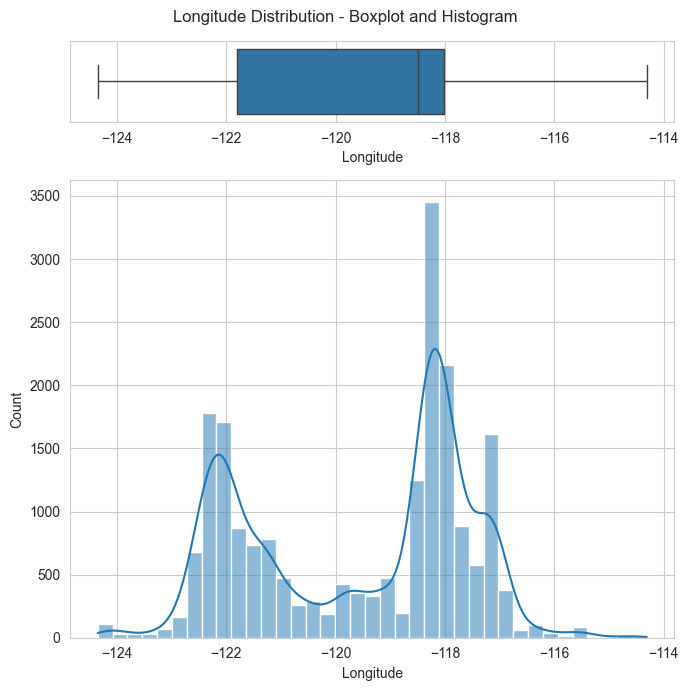

Longitude:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: -0.30 (approximately symmetric)
- Kurtosis: -1.33 (platykurtic (light tails, fewer outliers))


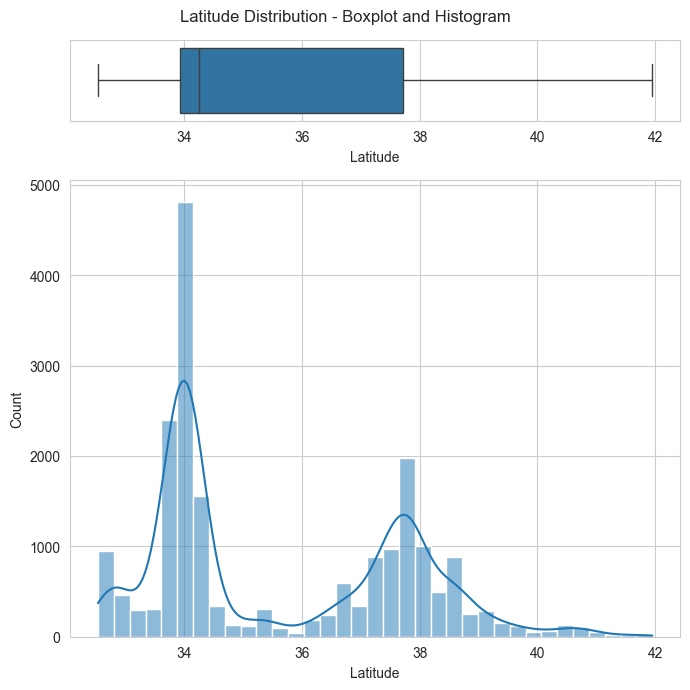

Latitude:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: 0.47 (approximately symmetric)
- Kurtosis: -1.12 (platykurtic (light tails, fewer outliers))


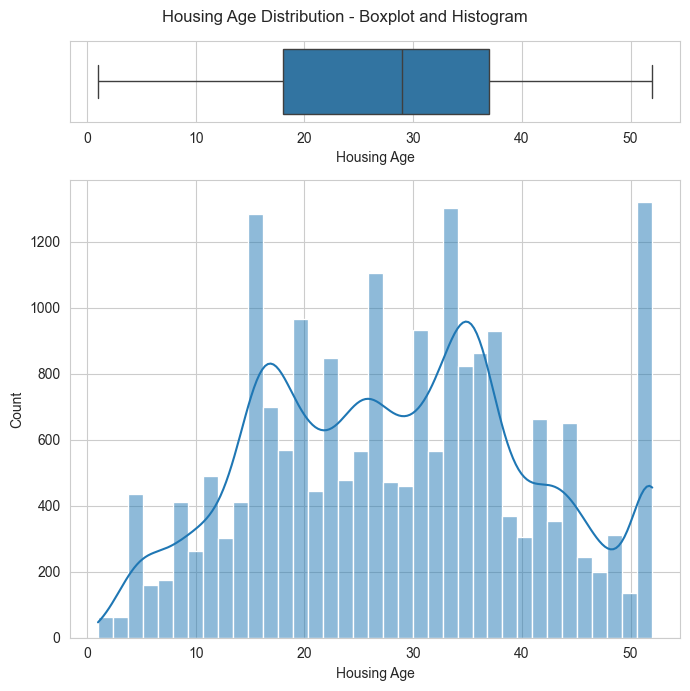

Housing Age:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: 0.06 (approximately symmetric)
- Kurtosis: -0.80 (platykurtic (light tails, fewer outliers))


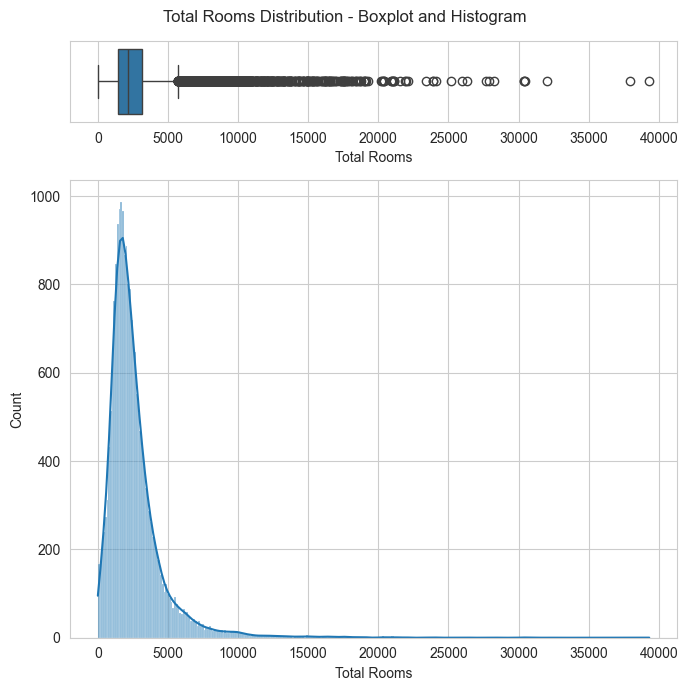

Total Rooms:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: 4.06 (right-skewed (long tail to the right))
- Kurtosis: 31.34 (leptokurtic (heavy tails, more outliers))


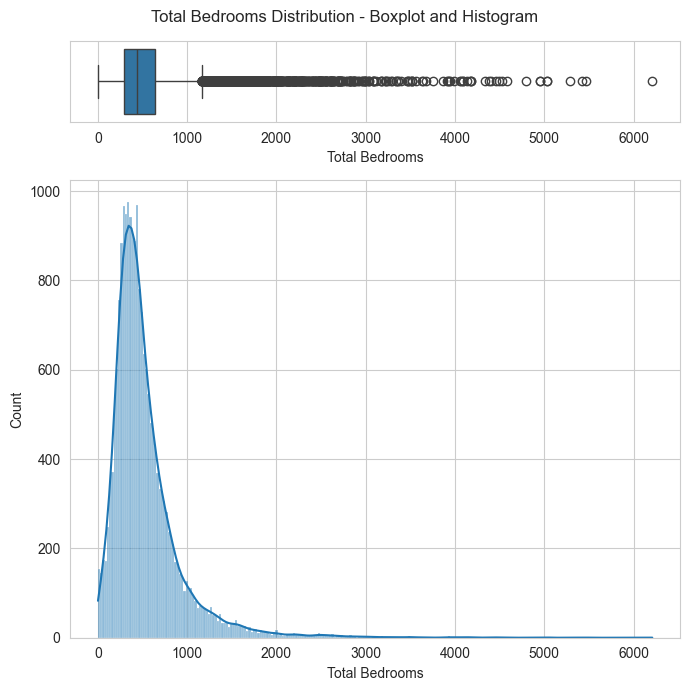

Total Bedrooms:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: 3.37 (right-skewed (long tail to the right))
- Kurtosis: 20.50 (leptokurtic (heavy tails, more outliers))


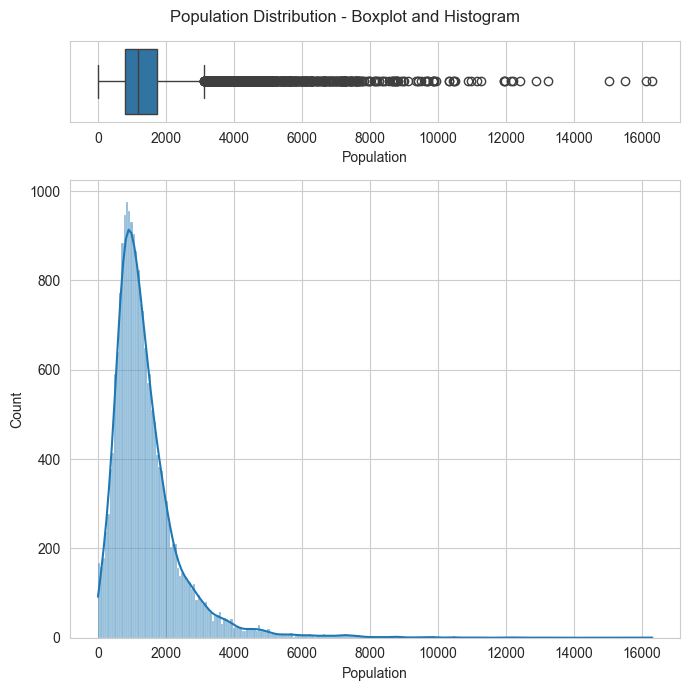

Population:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: 3.28 (right-skewed (long tail to the right))
- Kurtosis: 20.25 (leptokurtic (heavy tails, more outliers))


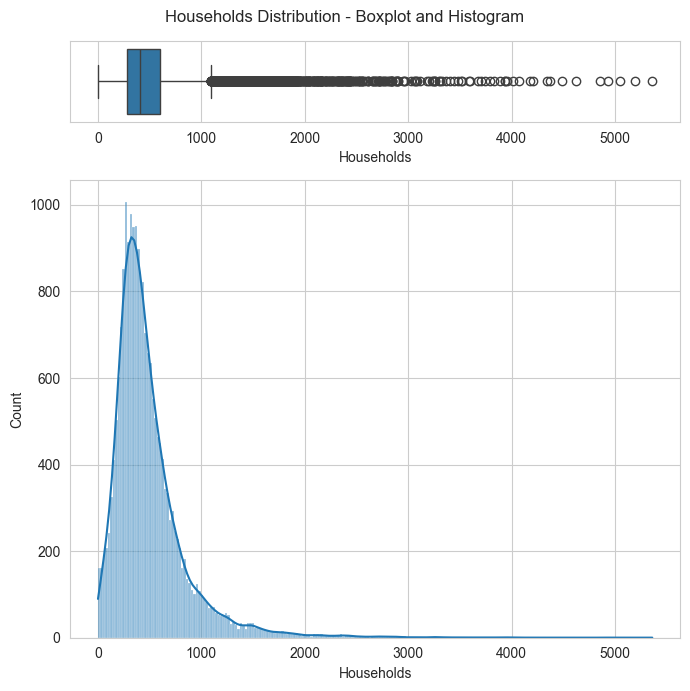

Households:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: 3.28 (right-skewed (long tail to the right))
- Kurtosis: 19.86 (leptokurtic (heavy tails, more outliers))


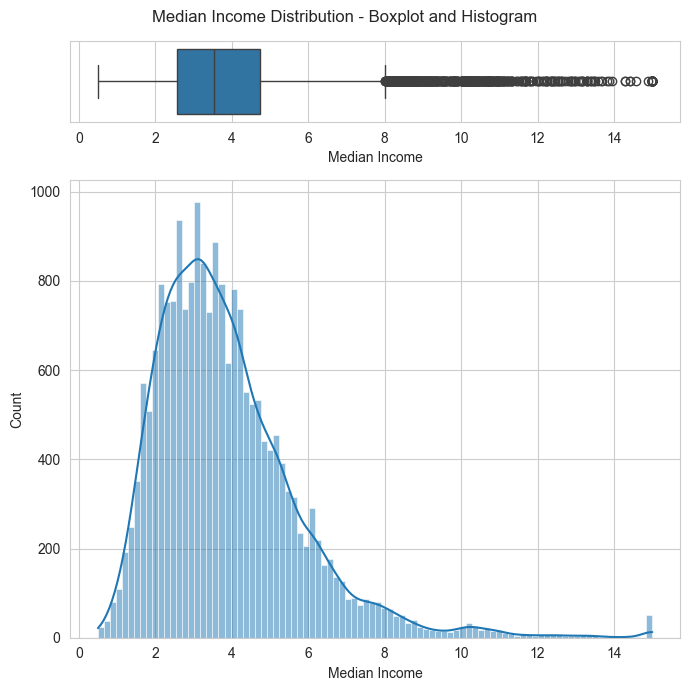

Median Income:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: 1.65 (right-skewed (long tail to the right))
- Kurtosis: 4.95 (leptokurtic (heavy tails, more outliers))


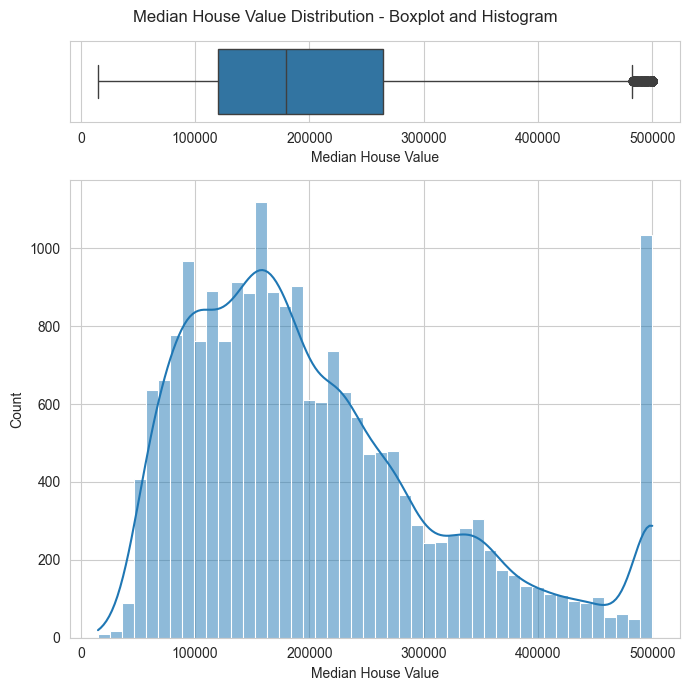

Median House Value:
- The boxplot (top) shows the spread, median, and potential outliers for this variable.
- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.
- Skewness: 0.98 (right-skewed (long tail to the right))
- Kurtosis: 0.33 (platykurtic (light tails, fewer outliers))


In [47]:
# For each numeric column in df_clean, plot both a boxplot (top) and a histogram with KDE (bottom).
# Then, print a summary of skewness and kurtosis for interpretation.
for col in df_clean.select_dtypes(include='number').columns:
  # Create a figure with two subplots: boxplot and histogram
  fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(7, 7), gridspec_kw={"height_ratios": (.15, .85)})
  
  # Boxplot (top)
  sns.boxplot(data=df_clean, x=col, ax=axes[0])
  
  # Histogram with KDE (bottom)
  sns.histplot(data=df_clean, x=col, kde=True, ax=axes[1])
  
  # Set the overall title and adjust layout
  fig.suptitle(f"{col} Distribution - Boxplot and Histogram")
  plt.tight_layout()
  plt.show()
  
  # Calculate skewness and kurtosis
  skew = df_clean[col].skew()
  kurt = df_clean[col].kurtosis()
  
  # Interpret skewness
  if abs(skew) < 0.5:
    skew_desc = "approximately symmetric"
  elif skew > 0.5:
    skew_desc = "right-skewed (long tail to the right)"
  else:
    skew_desc = "left-skewed (long tail to the left)"
  
  # Interpret kurtosis
  if kurt > 3:
    kurt_desc = "leptokurtic (heavy tails, more outliers)"
  elif kurt < 3:
    kurt_desc = "platykurtic (light tails, fewer outliers)"
  else:
    kurt_desc = "mesokurtic (normal tails)"
  
  # Print interpretation for each variable
  print(f"{col}:")
  print(f"- The boxplot (top) shows the spread, median, and potential outliers for this variable.")
  print(f"- The histogram (bottom) with KDE curve visualizes the frequency and shape of the distribution.")
  print(f"- Skewness: {skew:.2f} ({skew_desc})")
  print(f"- Kurtosis: {kurt:.2f} ({kurt_desc})")
  

#### Creating new columns:   Further Feature Engineering: 

Now we will create 5 more columns and add them to dataframe. 
4 numerical columns will be created from columns Total Rooms, Total Bedrooms, Population, Median House Value and catregorial column "income_category" will be created by putting into bins of very low, low, mediam, high , very high.
We will also check the shape and dataframe itself

In [48]:
# Feature engineering
df_clean["rooms_per_household"] = df_clean["Total Rooms"] / df_clean["Households"]
df_clean["bedrooms_per_room"] = df_clean["Total Bedrooms"] / df_clean["Total Rooms"]
df_clean["population_per_household"] = df_clean["Population"] / df_clean["Households"]
df_clean["price_per_room"] = df_clean["Median House Value"] / df_clean["Total Rooms"]
df_clean["income_category"] = pd.cut(
    df_clean["Median Income"],
    bins=[0, 2, 4, 6, 8, df_clean["Median Income"].max()],
    labels=["Very Low", "Low", "Medium", "High", "Very High"]
)
print(df_clean.shape)
df_clean.head()


(20638, 15)


,Longitude,Latitude,Housing Age,Total Rooms,Total Bedrooms,Population,Households,Median Income,Median House Value,ocean_proximity,rooms_per_household,bedrooms_per_room,population_per_household,price_per_room,income_category
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,0.146591,2.555556,514.318182,Very High
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,0.155797,2.109842,50.500070,Very High
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,8.288136,0.129516,2.802260,240.013633,High
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,5.817352,0.184458,2.547945,267.896389,Medium
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,6.281853,0.172096,2.181467,210.325753,Low


We will check the data types of columns again after creating new columns

In [49]:
# Display the data types of each column in the cleaned dataframe after feature engineering
df_clean.dtypes

Longitude                    float64
Latitude                     float64
Housing Age                  float64
Total Rooms                  float64
Total Bedrooms               float64
Population                   float64
Households                   float64
Median Income                float64
Median House Value           float64
ocean_proximity               object
rooms_per_household          float64
bedrooms_per_room            float64
population_per_household     float64
price_per_room               float64
income_category             category
dtype: object

#### Creating another categorical column based on newly created column population per household.
First we want to check the median value of newly created column population per household

In [50]:
# Display the median value of the 'population_per_household' column in the cleaned dataframe
df_clean['population_per_household'].median()

2.8180159733394623

Now we create anothe categorical column with categories of size of families

In [51]:
# Create bins and labels for categorizing 'population_per_household'
max_val = df_clean['population_per_household'].max()
bins = [-1, 0, 1, 2, 3, 4, 5, 5.00001, max_val + 1]  # Ensure last bin covers the max

labels = [
    'family of 0', 'family of< 1', 'family of< 2', 'family of< 3',
    'family of< 4', 'family of< 5', 'family of 5', 'family of> 5'
]

# Apply the binning to create a new categorical column
df_clean['pop_per_household_bins'] = pd.cut(
    df_clean['population_per_household'],
    bins=bins,
    labels=labels,
    right=False
)



We will check shape and dataframe again to see new column

In [52]:
# Display the shape of the cleaned dataframe and show the first few rows to verify new columns and data integrity
print(df_clean.shape)
df_clean.head()

(20638, 16)


,Longitude,Latitude,Housing Age,Total Rooms,Total Bedrooms,Population,Households,Median Income,Median House Value,ocean_proximity,rooms_per_household,bedrooms_per_room,population_per_household,price_per_room,income_category,pop_per_household_bins
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,0.146591,2.555556,514.318182,Very High,family of< 3
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,0.155797,2.109842,50.500070,Very High,family of< 3
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,8.288136,0.129516,2.802260,240.013633,High,family of< 3
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,5.817352,0.184458,2.547945,267.896389,Medium,family of< 3
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,6.281853,0.172096,2.181467,210.325753,Low,family of< 3


Now we will see the unique values of new column

In [53]:
# Display the unique values in the 'pop_per_household_bins' column of the cleaned dataframe
df_clean['pop_per_household_bins'].unique()

['family of< 3', 'family of< 2', 'family of< 4', 'family of< 5', 'family of> 5', 'family of< 1', 'family of 5']
Categories (8, object): ['family of 0' < 'family of< 1' < 'family of< 2' < 'family of< 3' < 'family of< 4' < 'family of< 5' < 'family of 5' < 'family of> 5']

Niw we will see how many of these unique values are.

In [54]:
# Display the count of each unique category in the 'pop_per_household_bins' column of the cleaned dataframe
df_clean['pop_per_household_bins'].value_counts()

pop_per_household_bins
family of< 3    10984
family of< 4     6273
family of< 2     1630
family of< 5     1403
family of> 5      344
family of< 1        3
family of 5         1
family of 0         0
Name: count, dtype: int64

Checkimg the dataframe again for any missing or null values

In [50]:
df_clean.isnull().sum()

Longitude                   0
Latitude                    0
Housing Age                 0
Total Rooms                 0
Total Bedrooms              0
Population                  0
Households                  0
Median Income               0
Median House Value          0
ocean_proximity             0
rooms_per_household         0
bedrooms_per_room           0
population_per_household    0
price_per_room              0
income_category             0
pop_per_household_bins      0
dtype: int64

#### Visualisations:
First, we check the distribution of newly created categorical column.

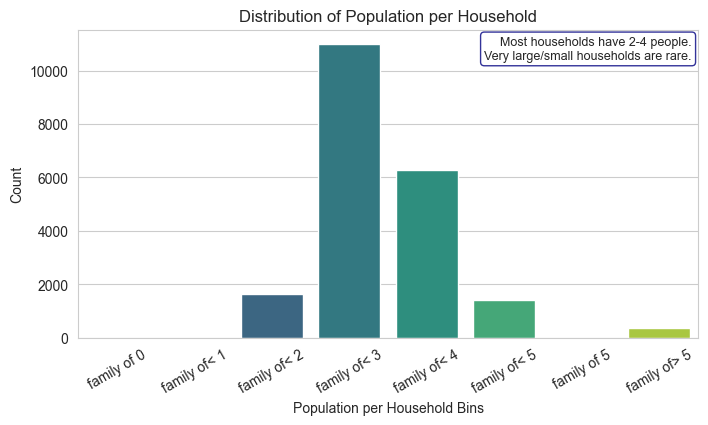

In [55]:
# Plot the distribution of the 'pop_per_household_bins' categorical feature
plt.figure(figsize=(8, 4))
sns.countplot(data=df_clean, x='pop_per_household_bins', palette='viridis')
plt.title("Distribution of Population per Household")
plt.xlabel("Population per Household Bins")
plt.ylabel("Count")
plt.xticks(rotation=30)

# Add a smaller explanation text box in the top right corner
explanation = (
    "Most households have 2-4 people.\n"
    "Very large/small households are rare."
)
plt.gca().text(
    0.99, 0.98, explanation, transform=plt.gca().transAxes,
    fontsize=9, verticalalignment='top', horizontalalignment='right',
    bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="navy", lw=1, alpha=0.8)
)

plt.show()



Now we check the distribution of other category column which we created income_category

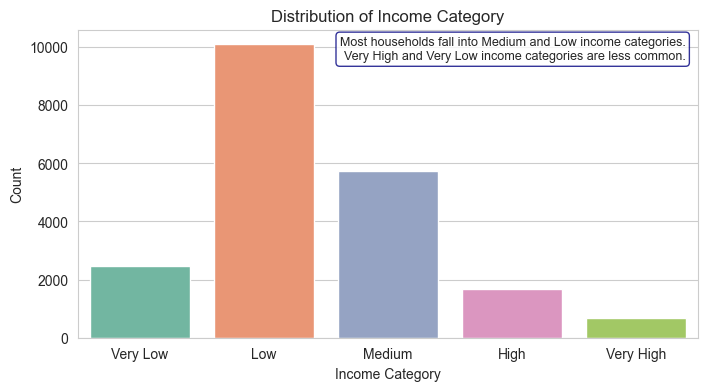

In [56]:
# Plot the distribution of the 'income_category' categorical feature
plt.figure(figsize=(8, 4))
sns.countplot(data=df_clean, x='income_category', palette='Set2')
plt.title("Distribution of Income Category")
plt.xlabel("Income Category")
plt.ylabel("Count")

# Add explanation in the top right corner, away from bars
explanation = (
    "Most households fall into Medium and Low income categories.\n"
    "Very High and Very Low income categories are less common."
)
plt.gca().text(
    0.98, 0.98, explanation, transform=plt.gca().transAxes,
    fontsize=9, verticalalignment='top', horizontalalignment='right',
    bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="navy", lw=1, alpha=0.8)
)

plt.show()

Checking the distribution of ocean proximity column which came with the dataset.


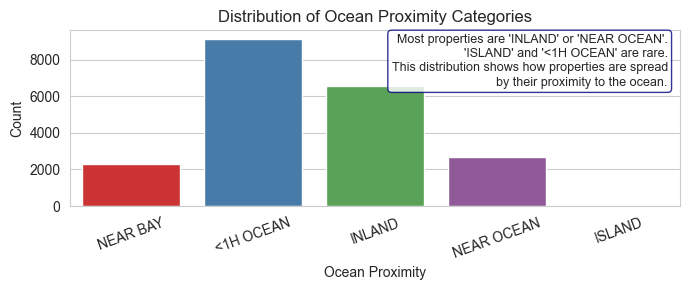

Description:
This histogram shows the frequency of each category in the 'ocean_proximity' variable from the cleaned dataset.
Explanation:
The 'ocean_proximity' variable indicates the location of each district relative to the ocean. The plot helps us understand the distribution of properties by their proximity to the ocean, which can be useful for analyzing trends in house values or demographics based on location.


In [58]:
# Plot the distribution of the 'ocean_proximity' categorical feature
plt.figure(figsize=(7, 3))
sns.countplot(data=df_clean, x='ocean_proximity', palette='Set1')
plt.title("Distribution of Ocean Proximity Categories")
plt.xlabel("Ocean Proximity")
plt.ylabel("Count")
plt.xticks(rotation=20)
plt.tight_layout()

# Add explanation in the top right corner, away from bars
explanation = (
    "Most properties are 'INLAND' or 'NEAR OCEAN'.\n"
    "'ISLAND' and '<1H OCEAN' are rare.\n"
    "This distribution shows how properties are spread\n"
    "by their proximity to the ocean."
)
plt.gca().text(
    0.98, 0.98, explanation, transform=plt.gca().transAxes,
    fontsize=9, verticalalignment='top', horizontalalignment='right',
    bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="navy", lw=1, alpha=0.8)
)

plt.show()

# Print a description of the plot and variable
print(
    "Description:\n"
    "This histogram shows the frequency of each category in the 'ocean_proximity' variable from the cleaned dataset.\n"
    "Explanation:\n"
    "The 'ocean_proximity' variable indicates the location of each district relative to the ocean. "
    "The plot helps us understand the distribution of properties by their proximity to the ocean, "
    "which can be useful for analyzing trends in house values or demographics based on location."
)

Now we Plot the distribution of ocean proximity by income category using a countplot

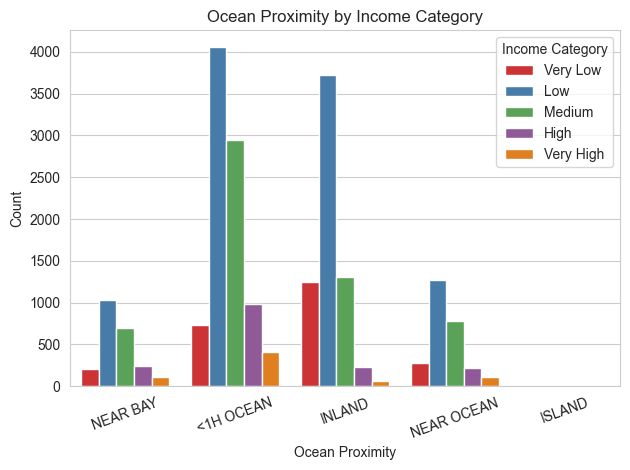

Explanation:
- This plot shows the distribution of income categories within each ocean proximity group.
- Most properties are 'INLAND' or 'NEAR OCEAN', and within each group,
  'Medium' and 'Low' income categories are the most common.
- 'Very High' income properties are more frequent near the ocean, while
  'Very Low' income properties are mostly inland.
- The '<1H OCEAN' and 'ISLAND' categories have fewer properties overall,
  with a mix of income levels.

Conclusion:
There is a clear relationship between proximity to the ocean and income category:
higher income households are more likely to be located near the ocean, while lower
income households are more common inland. This suggests that location is an important
factor in property value and household income distribution.


In [59]:
# Plot the distribution of ocean proximity by income category using a countplot
sns.countplot(data=df_clean, x='ocean_proximity', hue='income_category', palette='Set1')
plt.title("Ocean Proximity by Income Category")
plt.xlabel("Ocean Proximity")
plt.ylabel("Count")
plt.xticks(rotation=20)
plt.legend(title='Income Category', loc='upper right')
plt.tight_layout()
plt.show()

# Explanation and conclusion
print(
    "Explanation:\n"
    "- This plot shows the distribution of income categories within each ocean proximity group.\n"
    "- Most properties are 'INLAND' or 'NEAR OCEAN', and within each group,\n"
    "  'Medium' and 'Low' income categories are the most common.\n"
    "- 'Very High' income properties are more frequent near the ocean, while\n"
    "  'Very Low' income properties are mostly inland.\n"
    "- The '<1H OCEAN' and 'ISLAND' categories have fewer properties overall,\n"
    "  with a mix of income levels.\n"
    "\nConclusion:\n"
    "There is a clear relationship between proximity to the ocean and income category:\n"
    "higher income households are more likely to be located near the ocean, while lower\n"
    "income households are more common inland. This suggests that location is an important\n"
    "factor in property value and household income distribution."
)

#### Heatmap of all full dataframe including new varaiables

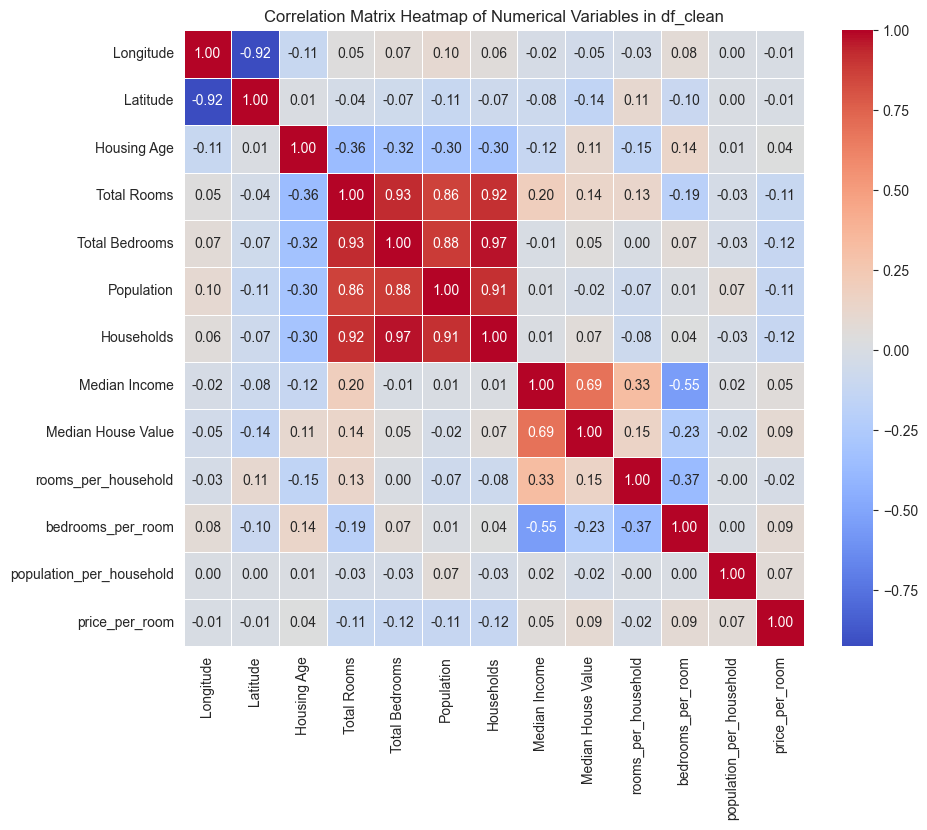

Explanation:
- 'Median Income' shows a strong positive correlation with 'Median House Value' (0.69),
  indicating that higher income areas tend to have higher house values.
- 'Total Rooms', 'Total Bedrooms', and 'Households' are highly correlated with each other (>0.9),
  which is expected as they are related features.
- 'Longitude' and 'Latitude' are negatively correlated, reflecting the geographic orientation of California.
- Most other variables have weak to moderate correlations with 'Median House Value'.

Conclusion:
The strongest predictor of house value in this dataset is 'Median Income'.
Room and household counts are highly interrelated, so multicollinearity should be considered in modeling.
Geographic variables also play a role but are less directly correlated with house value.


In [62]:
# Plot a heatmap of the correlation matrix for all numerical variables in df_clean
plt.figure(figsize=(10, 8))
sns.heatmap(df_clean.select_dtypes(include='number').corr(), annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix Heatmap of Numerical Variables in df_clean")
plt.show()

# Explanation and conclusion
print(
    "Explanation:\n"
    "- 'Median Income' shows a strong positive correlation with 'Median House Value' (0.69),\n"
    "  indicating that higher income areas tend to have higher house values.\n"
    "- 'Total Rooms', 'Total Bedrooms', and 'Households' are highly correlated with each other (>0.9),\n"
    "  which is expected as they are related features.\n"
    "- 'Longitude' and 'Latitude' are negatively correlated, reflecting the geographic orientation of California.\n"
    "- Most other variables have weak to moderate correlations with 'Median House Value'.\n"
    "\nConclusion:\n"
    "The strongest predictor of house value in this dataset is 'Median Income'.\n"
    "Room and household counts are highly interrelated, so multicollinearity should be considered in modeling.\n"
    "Geographic variables also play a role but are less directly correlated with house value."
)

#### KDE PLot of Median House Value by all key categorical variables

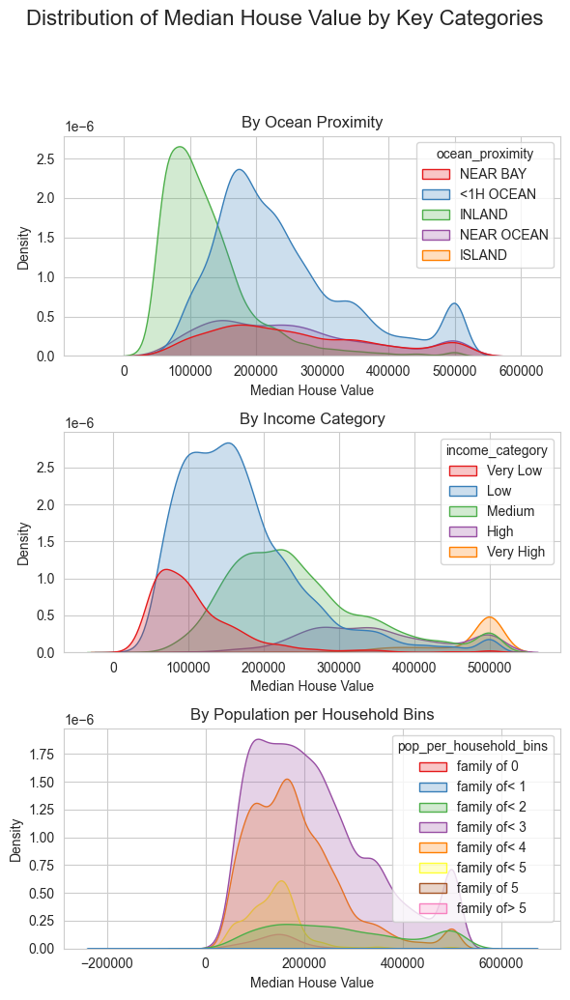

Description:
These plots show the distribution of Median House Value across three key categorical variables:
1. Ocean Proximity: Properties closer to the ocean tend to have higher house values, as seen by the right-shifted peaks for 'NEAR BAY' and 'NEAR OCEAN'.
2. Income Category: Higher income categories are associated with higher median house values, with clear separation between the distributions.
3. Population per Household Bins: Areas with larger household sizes tend to have lower house values, while smaller or average-sized households are more common in higher-value areas.

Explanation:
The distributions are right-skewed, indicating that while most properties have moderate values, there are some with very high house values. The separation between the curves for each category highlights the influence of location, income, and household size on property values in California.

Conclusion:
Location (proximity to the ocean), income level, and household size are all important factors
af

In [65]:
# Create a figure with 3 subplots (one for each key categorical variable)
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(6, 10))

# Set the overall title for the figure
fig.suptitle("Distribution of Median House Value by Key Categories", fontsize=16, y=1.03)

# KDE plot of Median House Value by ocean proximity
sns.kdeplot(
    data=df_clean,
    x='Median House Value',
    hue='ocean_proximity',
    ax=axes[0],
    fill=True,
    palette='Set1'
)
axes[0].set_title('By Ocean Proximity')
axes[0].set_xlabel('Median House Value')
axes[0].set_ylabel('Density')

# KDE plot of Median House Value by income category
sns.kdeplot(
    data=df_clean,
    x='Median House Value',
    hue='income_category',
    ax=axes[1],
    fill=True,
    palette='Set1'
)
axes[1].set_title('By Income Category')
axes[1].set_xlabel('Median House Value')
axes[1].set_ylabel('Density')

# KDE plot of Median House Value by population per household bins
sns.kdeplot(
    data=df_clean,
    x='Median House Value',
    hue='pop_per_household_bins',
    ax=axes[2],
    fill=True,
    palette='Set1'
)
axes[2].set_title('By Population per Household Bins')
axes[2].set_xlabel('Median House Value')
axes[2].set_ylabel('Density')

# Adjust layout to fit titles and labels
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

# Print description, explanation, and conclusion of the plots
print(
    "Description:\n"
    "These plots show the distribution of Median House Value across three key categorical variables:\n"
    "1. Ocean Proximity: Properties closer to the ocean tend to have higher house values, as seen by the right-shifted peaks for 'NEAR BAY' and 'NEAR OCEAN'.\n"
    "2. Income Category: Higher income categories are associated with higher median house values, with clear separation between the distributions.\n"
    "3. Population per Household Bins: Areas with larger household sizes tend to have lower house values, while smaller or average-sized households are more common in higher-value areas.\n\n"
    "Explanation:\n"
    "The distributions are right-skewed, indicating that while most properties have moderate values, there are some with very high house values. "
    "The separation between the curves for each category highlights the influence of location, income, and household size on property values in California.\n\n"
    "Conclusion:\n"
    "Location (proximity to the ocean), income level, and household size are all important factors\n"
    "affecting house values. Higher house values are concentrated in areas near the ocean and in\n"
    "higher income categories, while larger households are more common in lower-value areas.\n"
    "These insights can guide further modeling and policy decisions regarding housing in California."
)


#### Boxplot of Median House Value by Ocean Proximity

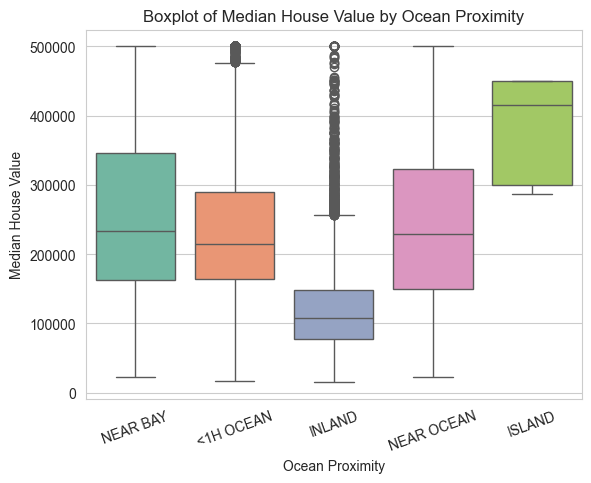

Explanation:
This boxplot visualizes the distribution of Median House Value for each Ocean Proximity category.
You can observe the median, interquartile range, and potential outliers for each group.
Generally, properties closer to the ocean (such as 'NEAR BAY' or 'NEAR OCEAN') tend to have higher median house values and wider value ranges compared to inland properties.
The spread and skewness of each box indicate variability and the presence of high-value outliers, especially in coastal areas.
This plot helps to compare how location relative to the ocean influences property values in California.

Conclusion:
Location has a significant impact on house values. Properties near the ocean typically command
higher prices and show greater variability, while inland properties have lower and more consistent values.
This insight is important for real estate analysis and policy decisions.


In [68]:
# Boxplot of Median House Value by Ocean Proximity
# This plot visualizes the distribution of house values for each ocean proximity category.
sns.boxplot(data=df_clean, x='ocean_proximity', y='Median House Value', palette='Set2')
plt.title("Boxplot of Median House Value by Ocean Proximity")
plt.xlabel("Ocean Proximity")
plt.ylabel("Median House Value")
plt.xticks(rotation=20)
plt.show()

# Explanation and conclusion:
print(
    "Explanation:\n"
    "This boxplot visualizes the distribution of Median House Value for each Ocean Proximity category.\n"
    "You can observe the median, interquartile range, and potential outliers for each group.\n"
    "Generally, properties closer to the ocean (such as 'NEAR BAY' or 'NEAR OCEAN') tend to have higher median house values and wider value ranges compared to inland properties.\n"
    "The spread and skewness of each box indicate variability and the presence of high-value outliers, especially in coastal areas.\n"
    "This plot helps to compare how location relative to the ocean influences property values in California.\n"
    "\nConclusion:\n"
    "Location has a significant impact on house values. Properties near the ocean typically command\n"
    "higher prices and show greater variability, while inland properties have lower and more consistent values.\n"
    "This insight is important for real estate analysis and policy decisions."
)

#### Boxplot of Median House Value by Ocean Proximity, split by Income Category


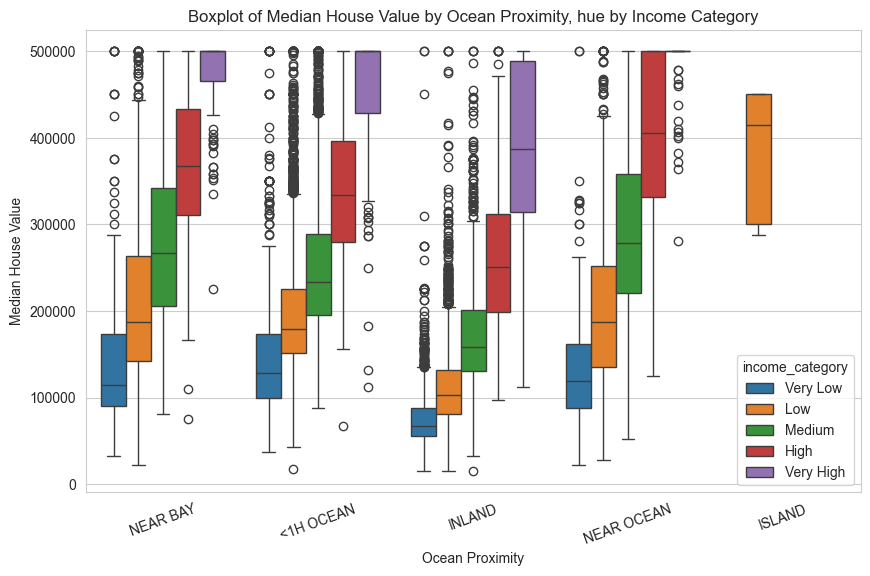

Explanation:
This boxplot visualizes how Median House Value varies across different Ocean Proximity
categories, further split by Income Category. You can observe that properties closer to
the ocean (such as 'NEAR BAY' and 'NEAR OCEAN') generally have higher median house values,
especially in higher income categories. Within each ocean proximity group, higher income
categories consistently show higher house values, with wider spreads and higher medians.
The plot also highlights the presence of outliers and the skewed distribution of house values,
particularly in coastal areas and higher income groups. This visualization helps to understand
the combined effect of location and income on property values in California.

Conclusion:
Both location (ocean proximity) and income category have a significant impact on house values.
Properties near the ocean and in higher income categories tend to have the highest house values.
This insight is important for understanding real estate trends and for 

In [71]:
# Boxplot of Median House Value by Ocean Proximity, split by Income Category
# This plot helps visualize how house values vary not only by proximity to the ocean,
# but also within each income category. It reveals the combined effect of location and income on property values.

plt.figure(figsize=(10, 6))
sns.boxplot(data=df_clean, x='ocean_proximity', y='Median House Value', hue='income_category')
plt.title("Boxplot of Median House Value by Ocean Proximity, hue by Income Category")
plt.xlabel("Ocean Proximity")
plt.ylabel("Median House Value")
plt.xticks(rotation=20)
plt.show()

print(
    "Explanation:\n"
    "This boxplot visualizes how Median House Value varies across different Ocean Proximity\n"
    "categories, further split by Income Category. You can observe that properties closer to\n"
    "the ocean (such as 'NEAR BAY' and 'NEAR OCEAN') generally have higher median house values,\n"
    "especially in higher income categories. Within each ocean proximity group, higher income\n"
    "categories consistently show higher house values, with wider spreads and higher medians.\n"
    "The plot also highlights the presence of outliers and the skewed distribution of house values,\n"
    "particularly in coastal areas and higher income groups. This visualization helps to understand\n"
    "the combined effect of location and income on property values in California.\n"
    "\nConclusion:\n"
    "Both location (ocean proximity) and income category have a significant impact on house values.\n"
    "Properties near the ocean and in higher income categories tend to have the highest house values.\n"
    "This insight is important for understanding real estate trends and for making informed decisions\n"
    "in housing policy and investment."
)

#### Joint Distribution of Median House Value and Housing Age by Ocean Proximity


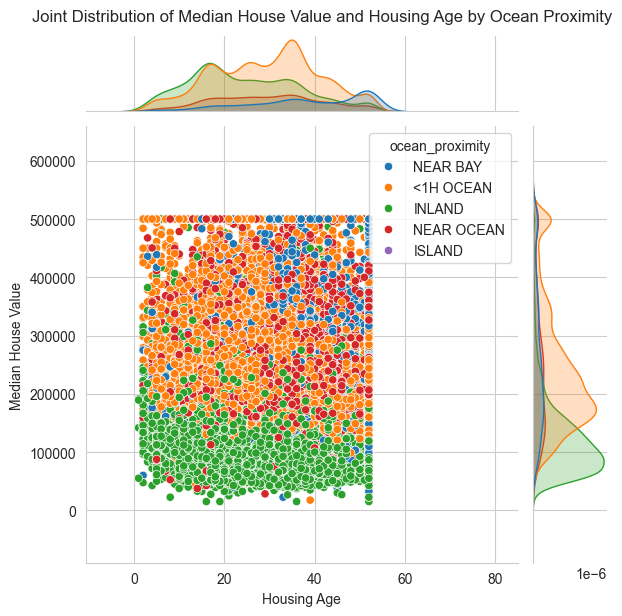

Explanation:
This jointplot visualizes the relationship between Housing Age and Median House Value,
colored by Ocean Proximity.
Observations:
- Properties near the ocean (e.g., 'NEAR BAY', 'NEAR OCEAN') generally have higher
  median house values across all housing ages.
- There is no strong linear relationship between housing age and house value; high-value
  properties exist at both low and high housing ages.
- Inland properties tend to cluster at lower house values, regardless of housing age.
- The spread of points shows that ocean proximity is a stronger factor for house value
  than housing age.

Conclusion:
Location relative to the ocean has a more pronounced effect on house prices than the age
of the property. Proximity to the ocean is a key driver of higher house values in California.


In [73]:
# Jointplot: Median House Value vs. Housing Age, colored by Ocean Proximity
# This plot visualizes the relationship between the age of housing and house values,
# with different colors for each ocean proximity category.

sns.jointplot(
    data=df_clean,
    y='Median House Value',
    x='Housing Age',
    hue='ocean_proximity'
)
plt.suptitle(
    "Joint Distribution of Median House Value and Housing Age by Ocean Proximity",
    y=1.02
)
plt.show()

print(
    "Explanation:\n"
    "This jointplot visualizes the relationship between Housing Age and Median House Value,\n"
    "colored by Ocean Proximity.\n"
    "Observations:\n"
    "- Properties near the ocean (e.g., 'NEAR BAY', 'NEAR OCEAN') generally have higher\n"
    "  median house values across all housing ages.\n"
    "- There is no strong linear relationship between housing age and house value; high-value\n"
    "  properties exist at both low and high housing ages.\n"
    "- Inland properties tend to cluster at lower house values, regardless of housing age.\n"
    "- The spread of points shows that ocean proximity is a stronger factor for house value\n"
    "  than housing age.\n"
    "\nConclusion:\n"
    "Location relative to the ocean has a more pronounced effect on house prices than the age\n"
    "of the property. Proximity to the ocean is a key driver of higher house values in California."
)

#### Plotting scatterplots of median house value by all numerical variables to check the trend with trend line

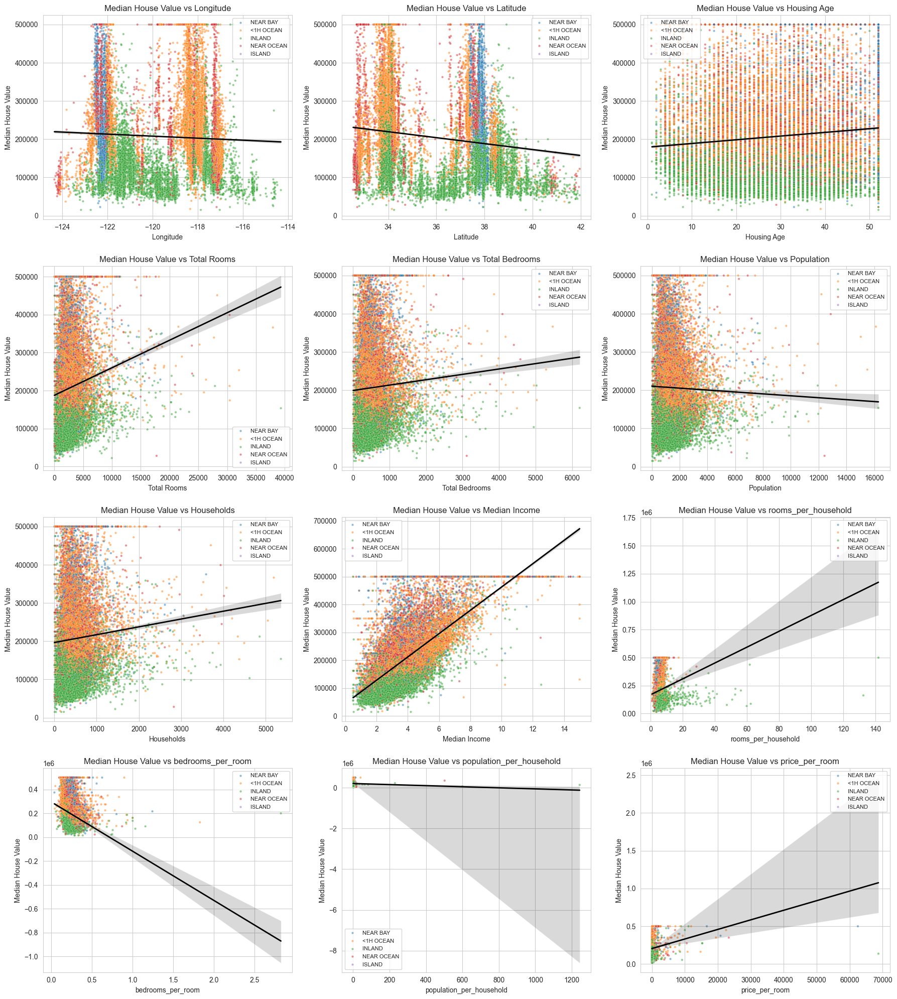

Explanation:
Each subplot shows the relationship between a numeric feature and Median House Value, colored by 'ocean_proximity'.
Regression lines (in black) indicate the overall trend between each feature and the target.

Observations:
- Features like Median Income show a strong positive correlation with Median House Value, as higher income areas tend to have higher house prices.
- Longitude and Latitude plots reveal geographic trends: properties closer to the coast (lower longitude, higher latitude) generally have higher values.
- Total Rooms, Total Bedrooms, and Households show positive but weaker relationships, with considerable spread and some outliers.
- Derived features such as rooms_per_household and bedrooms_per_room help reveal density and space per household, with higher values sometimes linked to higher house prices.
- price_per_room and population_per_household provide insight into affordability and crowding; higher price_per_room often corresponds to higher house values, w

In [75]:
# Get all columns except the target variable
target = 'Median House Value'
features = [col for col in df_clean.columns if col != target and pd.api.types.is_numeric_dtype(df_clean[col])]

n_cols = 3
n_rows = math.ceil(len(features) / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 5 * n_rows))
axes = axes.flatten()

for i, feature in enumerate(features):
    ax = axes[i]
    sns.scatterplot(
        data=df_clean,
        x=feature,
        y=target,
        hue='ocean_proximity',
        alpha=0.5,
        s=10,
        ax=ax
    )
    sns.regplot(
        data=df_clean,
        x=feature,
        y=target,
        scatter=False,
        ax=ax,
        color='black',
        line_kws={'linewidth': 2}
    )
    ax.set_title(f"{target} vs {feature}")
    ax.legend(loc='best', fontsize=8)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

print(
    "Explanation:\n"
    "Each subplot shows the relationship between a numeric feature and Median House Value, "
    "colored by 'ocean_proximity'.\n"
    "Regression lines (in black) indicate the overall trend between each feature and the target.\n"
    "\n"
    "Observations:\n"
    "- Features like Median Income show a strong positive correlation with Median House Value, "
    "as higher income areas tend to have higher house prices.\n"
    "- Longitude and Latitude plots reveal geographic trends: properties closer to the coast "
    "(lower longitude, higher latitude) generally have higher values.\n"
    "- Total Rooms, Total Bedrooms, and Households show positive but weaker relationships, "
    "with considerable spread and some outliers.\n"
    "- Derived features such as rooms_per_household and bedrooms_per_room help reveal density "
    "and space per household, with higher values sometimes linked to higher house prices.\n"
    "- price_per_room and population_per_household provide insight into affordability and crowding; "
    "higher price_per_room often corresponds to higher house values, while higher population_per_household "
    "may indicate lower values.\n"
    "- The color coding by 'ocean_proximity' shows that properties near the ocean or bay tend to cluster "
    "at higher house values across most features.\n"
    "\n"
    "Overall, the plots highlight both linear and non-linear relationships, the effect of outliers, "
    "and the importance of location and income in determining house prices in California.\n"
    "\n"
    "Conclusion:\n"
    "The analysis demonstrates that Median Income and proximity to the ocean are the most influential "
    "factors affecting house prices in California.\n"
    "Other features such as total rooms, households, and derived ratios also contribute, but to a lesser extent.\n"
    "Understanding these relationships can help in predicting house values and identifying key drivers "
    "in the housing market."
)


#### lmplot of House Value by Median Income

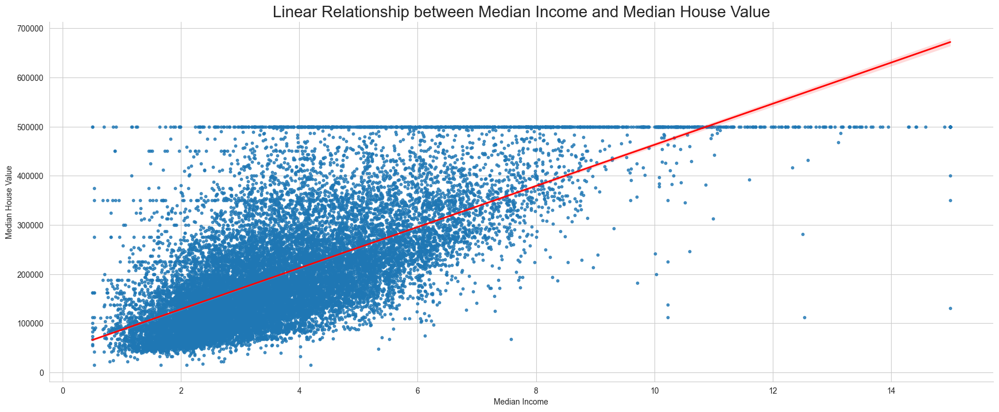

Explanation:
This plot shows the relationship between Median Income and Median House Value
in California districts. The red trend line indicates a strong positive linear
relationship: as median income increases, median house value also tends to rise.
Most data points are concentrated at lower income and house value levels, but
there is a clear upward trend.

Conclusion:
Higher income areas generally have higher house prices, suggesting that income
is a key driver of property values in this dataset.


In [105]:
# Plotting the linear relationship between Median Income and Median House Value
# using seaborn's lmplot for regression visualization.
# The red trend line shows the linear fit.

sns.lmplot(
    data=df_clean,
    x="Median Income",
    y="Median House Value",
    scatter_kws={'s': 10},
    line_kws={'color': 'red', 'linewidth': 2},
    height=7,
    aspect=2.5,
    order=1
)
plt.title("Linear Relationship between Median Income and Median House Value", fontsize=20)
plt.show()

print(
    "Explanation:\n"
    "This plot shows the relationship between Median Income and Median House Value\n"
    "in California districts. The red trend line indicates a strong positive linear\n"
    "relationship: as median income increases, median house value also tends to rise.\n"
    "Most data points are concentrated at lower income and house value levels, but\n"
    "there is a clear upward trend.\n"
    "\n"
    "Conclusion:\n"
    "Higher income areas generally have higher house prices, suggesting that income\n"
    "is a key driver of property values in this dataset."
)


#### Scatter plot: Median Income vs Median House Value, colored by ocean_proximity, size by Median Income, with trend line

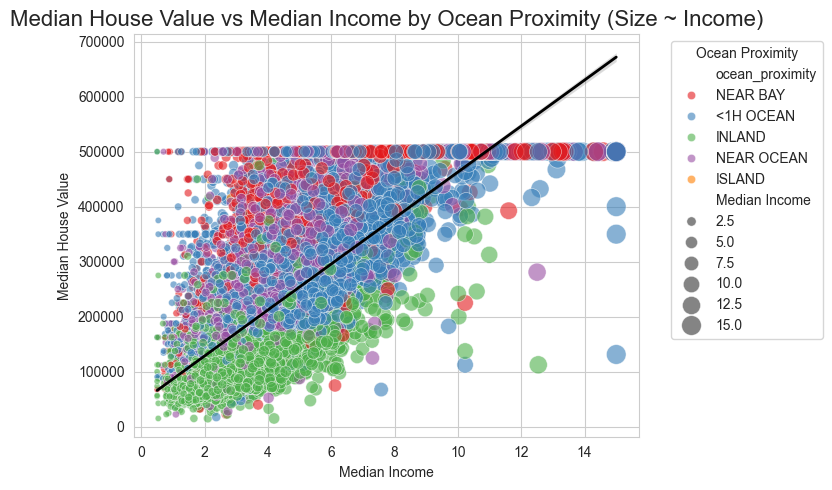

Explanation:
The scatter plot shows a clear positive relationship between Median Income
and Median House Value. Larger points represent higher income districts,
which tend to cluster at higher house values. Properties near the ocean
(e.g., 'NEAR BAY', 'NEAR OCEAN') generally have higher house values at
similar income levels compared to inland properties. The black trend line
highlights the strong linear association between income and house value.

Conclusion:
Higher income is strongly associated with higher house values, and proximity
to the ocean further increases property values. This demonstrates that both
income and location are key drivers of house prices in California.


In [107]:
# Scatter plot: Median Income vs Median House Value, colored by ocean_proximity, size by Median Income, with trend line

plt.figure(figsize=(8, 5))

# Create scatter plot with hue as ocean_proximity and size as Median Income
sns.scatterplot(
    data=df_clean,
    x='Median Income',
    y='Median House Value',
    hue='ocean_proximity',
    size='Median Income',
    sizes=(20, 200),
    alpha=0.6,
    palette='Set1',
    legend='brief'
)

# Fit and plot a linear regression trend line
sns.regplot(
    data=df_clean,
    x='Median Income',
    y='Median House Value',
    scatter=False,
    color='black',
    line_kws={'linewidth': 2}
)

plt.title("Median House Value vs Median Income by Ocean Proximity (Size ~ Income)", fontsize=16)
plt.xlabel("Median Income")
plt.ylabel("Median House Value")
plt.legend(title='Ocean Proximity', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

print(
    "Explanation:\n"
    "The scatter plot shows a clear positive relationship between Median Income\n"
    "and Median House Value. Larger points represent higher income districts,\n"
    "which tend to cluster at higher house values. Properties near the ocean\n"
    "(e.g., 'NEAR BAY', 'NEAR OCEAN') generally have higher house values at\n"
    "similar income levels compared to inland properties. The black trend line\n"
    "highlights the strong linear association between income and house value.\n"
    "\nConclusion:\n"
    "Higher income is strongly associated with higher house values, and proximity\n"
    "to the ocean further increases property values. This demonstrates that both\n"
    "income and location are key drivers of house prices in California."
)

#### Scatter plot of Median House Value vs Longitude, colored by Ocean Proximity, with trend line

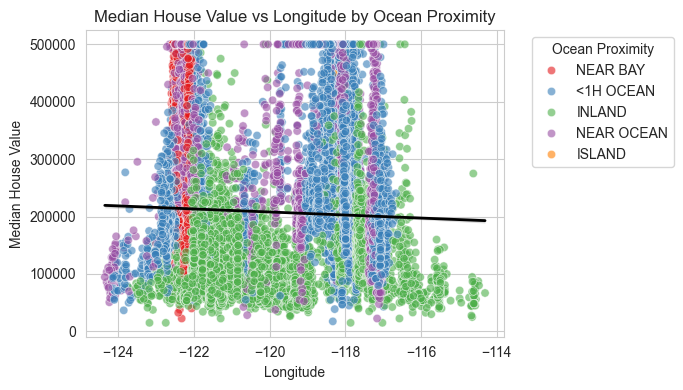

Explanation:
- This scatter plot shows how Median House Value varies with Longitude, colored by Ocean Proximity.
- Properties with lower longitude (further west, closer to the Pacific coast) generally have higher house values.
- The trend line indicates a weak negative relationship: as longitude increases (moving east), house values tend to decrease.
- Most high-value properties are clustered at lower longitudes and are often near the ocean or bay.
- Inland properties (higher longitude) tend to have lower house values.

Conclusion:
Geographic location, especially proximity to the coast (lower longitude), is associated with higher property values in California.
Ocean proximity further amplifies this effect, as seen by the color groupings. This highlights the importance of location in real estate pricing.


In [108]:
# Scatter plot of Median House Value vs Longitude, colored by Ocean Proximity, with trend line
fig, axes = plt.subplots(figsize=(7, 4))
sns.scatterplot(
    data=df_clean,
    x='Longitude',
    y='Median House Value',
    hue='ocean_proximity',
    alpha=0.6,
    palette='Set1',
    ax=axes
)
# Fit and plot a linear regression trend line (ignoring hue for overall trend)
sns.regplot(
    data=df_clean,
    x='Longitude',
    y='Median House Value',
    scatter=False,
    color='black',
    line_kws={'linewidth': 2},
    ax=axes
)
plt.title("Median House Value vs Longitude by Ocean Proximity")
plt.xlabel("Longitude")
plt.ylabel("Median House Value")
plt.legend(title='Ocean Proximity', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

print(
    "Explanation:\n"
    "- This scatter plot shows how Median House Value varies with Longitude, "
    "colored by Ocean Proximity.\n"
    "- Properties with lower longitude (further west, closer to the Pacific coast) "
    "generally have higher house values.\n"
    "- The trend line indicates a weak negative relationship: as longitude increases "
    "(moving east), house values tend to decrease.\n"
    "- Most high-value properties are clustered at lower longitudes and are often near "
    "the ocean or bay.\n"
    "- Inland properties (higher longitude) tend to have lower house values.\n"
    "\nConclusion:\n"
    "Geographic location, especially proximity to the coast (lower longitude), is "
    "associated with higher property values in California.\n"
    "Ocean proximity further amplifies this effect, as seen by the color groupings. "
    "This highlights the importance of location in real estate pricing."
)

#### Scatter plot and trend line: Median House Value vs Housing Age

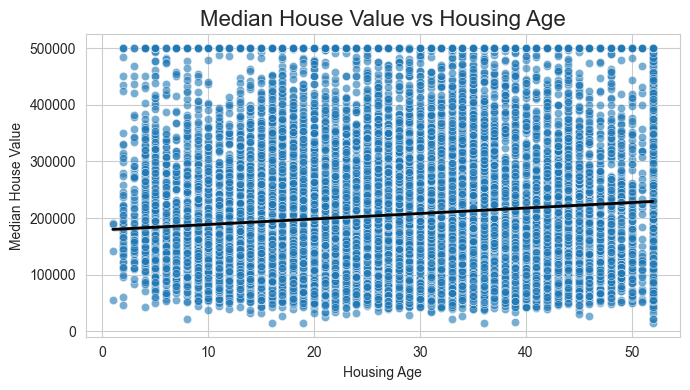

Explanation:
- The scatter plot shows the relationship between Housing Age and
  Median House Value.
- The trend line indicates a weak positive relationship: as housing
  age increases, median house value tends to increase slightly, but
  the effect is not strong.
- There is a wide spread of house values at each housing age,
  suggesting other factors (like location and income) are more
  influential.

Conclusion:
While housing age has a minor positive effect on house value, other
variables are much stronger predictors.


In [ ]:
# Scatter plot and trend line: Median House Value vs Housing Age
# This plot visualizes the relationship between the age of housing and house values.
fig, axes = plt.subplots(figsize=(7, 4))
sns.scatterplot(
    data=df_clean,
    x='Housing Age',
    y='Median House Value',
    alpha=0.6,
    ax=axes
)
# Fit and plot a linear regression trend line
sns.regplot(
    data=df_clean,
    x='Housing Age',
    y='Median House Value',
    scatter=False,
    color='black',
    line_kws={'linewidth': 2},
    ax=axes
)
axes.set_title("Median House Value vs Housing Age", fontsize=16)
axes.set_xlabel("Housing Age")
axes.set_ylabel("Median House Value")
plt.tight_layout()
plt.show()

print(
    "Explanation:\n"
    "- The scatter plot shows the relationship between Housing Age and\n"
    "  Median House Value.\n"
    "- The trend line indicates a weak positive relationship: as housing\n"
    "  age increases, median house value tends to increase slightly, but\n"
    "  the effect is not strong.\n"
    "- There is a wide spread of house values at each housing age,\n"
    "  suggesting other factors (like location and income) are more\n"
    "  influential.\n"
    "\nConclusion:\n"
    "While housing age has a minor positive effect on house value, other\n"
    "variables are much stronger predictors."
)


#### Scatter plot: Median House Value vs Housing Age, colored by Ocean Proximity, size by Median Income

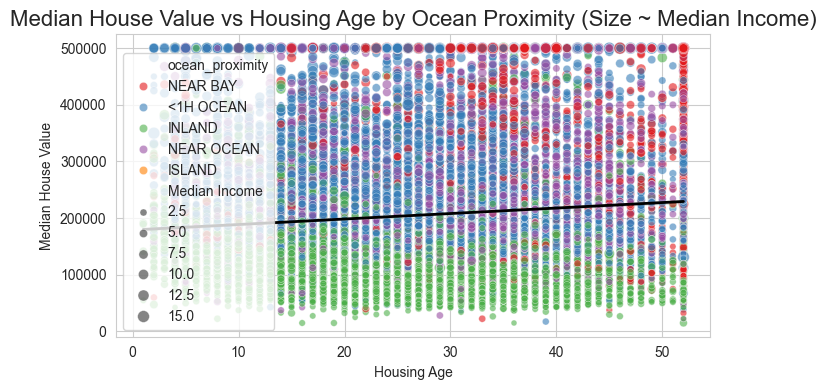

Explanation:
- The scatter plot shows the relationship between Housing Age and Median House Value,
  colored by Ocean Proximity and sized by Median Income.
- Properties near the ocean (e.g., 'NEAR BAY', 'NEAR OCEAN') generally have higher house values
  across all housing ages.
- The trend line indicates a weak positive relationship: as housing age increases, median house value
  tends to increase slightly, but the effect is not strong.
- Larger points (higher income) are concentrated at higher house values, showing that income is a strong
  driver regardless of housing age.
- There is a wide spread of house values at each housing age, suggesting other factors (like location and income)
  are more influential.

Conclusion:
While housing age has a minor positive effect on house value, location (ocean proximity) and income are much
stronger predictors. Older properties near the ocean with higher incomes tend to have the highest house values.


In [111]:
# Scatter plot: Median House Value vs Housing Age, colored by Ocean Proximity, size by Median Income
# This plot visualizes the relationship between housing age and house values,
# with color indicating ocean proximity and point size representing median income.

fig, axes = plt.subplots(figsize=(7, 4))
sns.scatterplot(
    data=df_clean,
    x='Housing Age',
    y='Median House Value',
    hue='ocean_proximity',
    size='Median Income',
    alpha=0.6,
    palette='Set1',
    ax=axes
)
# Fit and plot a linear regression trend line (ignoring hue/size for overall trend)
sns.regplot(
    data=df_clean,
    x='Housing Age',
    y='Median House Value',
    scatter=False,
    color='black',
    line_kws={'linewidth': 2},
    ax=axes
)
axes.set_title("Median House Value vs Housing Age by Ocean Proximity (Size ~ Median Income)", fontsize=16)
axes.set_xlabel("Housing Age")
axes.set_ylabel("Median House Value")
plt.tight_layout()
plt.show()

print(
    "Explanation:\n"
    "- The scatter plot shows the relationship between Housing Age and Median House Value,\n"
    "  colored by Ocean Proximity and sized by Median Income.\n"
    "- Properties near the ocean (e.g., 'NEAR BAY', 'NEAR OCEAN') generally have higher house values\n"
    "  across all housing ages.\n"
    "- The trend line indicates a weak positive relationship: as housing age increases, median house value\n"
    "  tends to increase slightly, but the effect is not strong.\n"
    "- Larger points (higher income) are concentrated at higher house values, showing that income is a strong\n"
    "  driver regardless of housing age.\n"
    "- There is a wide spread of house values at each housing age, suggesting other factors (like location and income)\n"
    "  are more influential.\n"
    "\nConclusion:\n"
    "While housing age has a minor positive effect on house value, location (ocean proximity) and income are much\n"
    "stronger predictors. Older properties near the ocean with higher incomes tend to have the highest house values."
)

#### Stacked Area plot of House value by income category stacked by family aize


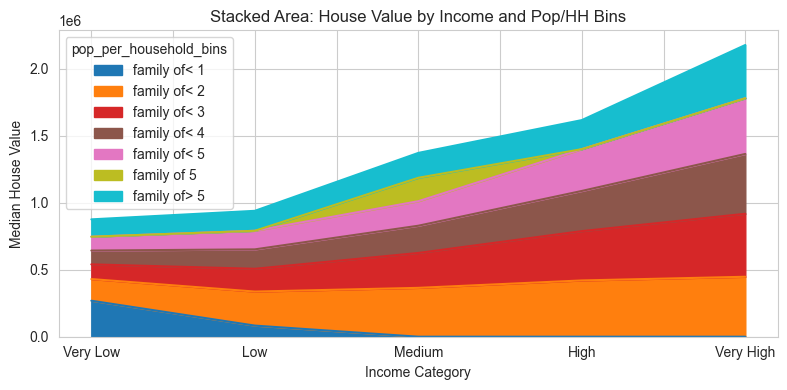

Explanation:
- This stacked area plot shows the average Median House Value for each income category,
  broken down by population per household bins.
- Higher income categories ('High', 'Very High') have much higher house values, and their
  areas dominate the upper part of the plot.
- Within each income group, most house value comes from households with 2-4 people (the largest
  colored areas), reflecting the most common household sizes.
- Households with very large or very small populations contribute less to the total house value,
  as seen by the smaller areas at the top and bottom.

Conclusion:
Median House Value increases strongly with income category, and typical household sizes (2-4 people)
are most prevalent in all groups. Very high or very low population per household is rare and less
influential on overall house values. This visualization highlights the combined effect of income and
household size on property values.


In [118]:
# Create a pivot table to calculate the mean Median House Value for each combination
# of income_category and pop_per_household_bins
pivot_df = df_clean.pivot_table(
    index='income_category',
    columns='pop_per_household_bins',
    values='Median House Value',
    aggfunc='mean'
)

# Plot a stacked area chart of the pivot table
pivot_df.plot(kind='area', stacked=True, figsize=(8, 4), colormap='tab10')
plt.title('Stacked Area: House Value by Income and Pop/HH Bins')
plt.xlabel('Income Category')
plt.ylabel('Median House Value')
plt.tight_layout()
plt.show()

print(
    "Explanation:\n"
    "- This stacked area plot shows the average Median House Value for each income category,\n"
    "  broken down by population per household bins.\n"
    "- Higher income categories ('High', 'Very High') have much higher house values, and their\n"
    "  areas dominate the upper part of the plot.\n"
    "- Within each income group, most house value comes from households with 2-4 people (the largest\n"
    "  colored areas), reflecting the most common household sizes.\n"
    "- Households with very large or very small populations contribute less to the total house value,\n"
    "  as seen by the smaller areas at the top and bottom.\n"
    "\nConclusion:\n"
    "Median House Value increases strongly with income category, and typical household sizes (2-4 people)\n"
    "are most prevalent in all groups. Very high or very low population per household is rare and less\n"
    "influential on overall house values. This visualization highlights the combined effect of income and\n"
    "household size on property values."
)

#### Stacked Area plot 2:

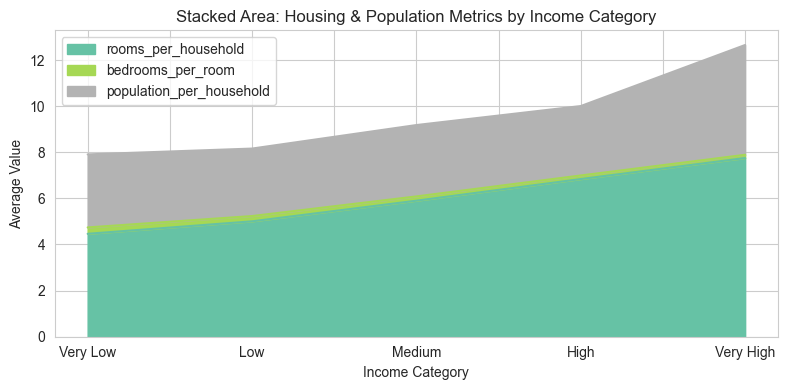

Explanation:
- This stacked area plot shows the average values of three key metrics—
  rooms per household, bedrooms per room, and population per household—
  across income categories.
- As income category increases, the average number of rooms per household rises,
  indicating that higher income areas tend to have larger homes.
- The bedrooms per room ratio decreases with income, suggesting that higher income
  households have a greater proportion of non-bedroom rooms (e.g., living rooms,
  offices), reflecting more spacious or luxurious homes.
- Population per household is relatively stable across most income categories, with
  a slight increase in the highest income group, possibly due to larger family homes.

Conclusion:
Higher income categories are associated with larger, less crowded, and more spacious
homes. The metrics highlight how housing characteristics improve with income, reflecting
greater living space and comfort in wealthier areas.


In [119]:
# Calculate the mean of key housing and population metrics by income category
metrics = df_clean.groupby('income_category')[
    ['rooms_per_household', 'bedrooms_per_room', 'population_per_household']
].mean()

# Plot a stacked area chart to visualize these metrics across income categories
metrics.plot(kind='area', stacked=True, figsize=(8, 4), colormap='Set2')
plt.title('Stacked Area: Housing & Population Metrics by Income Category')
plt.ylabel('Average Value')
plt.xlabel('Income Category')
plt.tight_layout()
plt.show()

print(
    "Explanation:\n"
    "- This stacked area plot shows the average values of three key metrics—\n"
    "  rooms per household, bedrooms per room, and population per household—\n"
    "  across income categories.\n"
    "- As income category increases, the average number of rooms per household rises,\n"
    "  indicating that higher income areas tend to have larger homes.\n"
    "- The bedrooms per room ratio decreases with income, suggesting that higher income\n"
    "  households have a greater proportion of non-bedroom rooms (e.g., living rooms,\n"
    "  offices), reflecting more spacious or luxurious homes.\n"
    "- Population per household is relatively stable across most income categories, with\n"
    "  a slight increase in the highest income group, possibly due to larger family homes.\n"
    "\nConclusion:\n"
    "Higher income categories are associated with larger, less crowded, and more spacious\n"
    "homes. The metrics highlight how housing characteristics improve with income, reflecting\n"
    "greater living space and comfort in wealthier areas."
)

#### Plotly Area PLot by Median House Value, Income category and population per household

In [128]:
# Plotly Area Plot: Median House Value by Income Category and Population per Household
# This plot visualizes how median house values vary across income categories,
# further broken down by population per household bins.

import plotly.express as px

# Prepare the data for plotting
area_data = df_clean.groupby(['income_category', 'pop_per_household_bins'])['Median House Value'].mean().reset_index()

# Create the area plot using Plotly Express
fig_area = px.area(
    area_data,
    x='income_category',
    y='Median House Value',
    color='pop_per_household_bins',
    line_group='pop_per_household_bins',
    labels={
        'income_category': 'Income Category',
        'Median House Value': 'Median House Value',
        'pop_per_household_bins': 'Population per Household Bins'
    },
    title='Plotly Area Plot: Median House Value by Income Category and Population per Household',
    color_discrete_sequence=px.colors.qualitative.Set2
)
fig_area.update_layout(
    legend_title_text='Population per Household Bins',
    xaxis_title='Income Category',
    yaxis_title='Median House Value',
    width=800,
    height=400
)
fig_area.show()

# Explanation and conclusion (formatted for readability)
print(
    "Explanation:\n"
    "This area plot shows the average Median House Value for each income category,\n"
    "with different colored areas representing population per household bins.\n"
    "Higher income categories ('High', 'Very High') have much higher house values.\n"
    "Within each income group, most house value comes from households with 2-4 people,\n"
    "as indicated by the largest colored areas. Households with very large or very small\n"
    "populations contribute less to the total house value, as seen by the smaller areas.\n"
    "\nConclusion:\n"
    "Median House Value increases strongly with income category, and typical household sizes\n"
    "(2-4 people) are most prevalent in all groups. Very high or very low population per household\n"
    "is rare and less influential on overall house values. This visualization highlights the\n"
    "combined effect of income and household size on property values."
)

Explanation:
This area plot shows the average Median House Value for each income category,
with different colored areas representing population per household bins.
Higher income categories ('High', 'Very High') have much higher house values.
Within each income group, most house value comes from households with 2-4 people,
as indicated by the largest colored areas. Households with very large or very small
populations contribute less to the total house value, as seen by the smaller areas.

Conclusion:
Median House Value increases strongly with income category, and typical household sizes
(2-4 people) are most prevalent in all groups. Very high or very low population per household
is rare and less influential on overall house values. This visualization highlights the
combined effect of income and household size on property values.


#### Plotly 3D Scatter plot 

In [130]:
fig = px.scatter_3d(
    df_clean,
    x="Median Income",
    y="Median House Value",
    z="Housing Age",
    color='ocean_proximity',
    color_discrete_sequence=px.colors.qualitative.Vivid,
    title="3D Scatter Plot:<br>Median Income vs Median House Value vs Housing Age<br>by Ocean Proximity"
)
fig.update_layout(width=700, height=500)
fig.show()

print(
    "Explanation:\n"
    "- This 3D scatter plot shows how Median House Value varies with Median Income and Housing Age.\n"
    "- Each point represents a district, colored by its proximity to the ocean.\n"
    "- Higher income areas (right side) generally have higher house values (upper side).\n"
    "- Properties near the ocean (e.g., 'NEAR BAY', 'NEAR OCEAN') tend to cluster at higher values.\n"
    "- Housing age does not show a strong linear relationship with house value or income, but some patterns\n"
    "  may be visible in the spatial arrangement of points.\n"
    "\nConclusion:\n"
    "This visualization highlights the strong positive relationship between income and house value, and the\n"
    "impact of ocean proximity. Housing age has less influence compared to income and location. The 3D plot\n"
    "allows for interactive exploration of these relationships in the California housing dataset."
)


Explanation:
- This 3D scatter plot shows how Median House Value varies with Median Income and Housing Age.
- Each point represents a district, colored by its proximity to the ocean.
- Higher income areas (right side) generally have higher house values (upper side).
- Properties near the ocean (e.g., 'NEAR BAY', 'NEAR OCEAN') tend to cluster at higher values.
- Housing age does not show a strong linear relationship with house value or income, but some patterns
  may be visible in the spatial arrangement of points.

Conclusion:
This visualization highlights the strong positive relationship between income and house value, and the
impact of ocean proximity. Housing age has less influence compared to income and location. The 3D plot
allows for interactive exploration of these relationships in the California housing dataset.


#### PLotly Scatter plot of Median Income vs Median House Value, colored by ocean proximity

In [133]:
# Plotly scatter plot: Median Income vs Median House Value, colored by ocean proximity
fig = px.scatter(
    df_clean,
    x="Median Income",
    y="Median House Value",
    color='ocean_proximity',
    title="Scatter Plot: Median Income vs Median House Value<br>by Ocean Proximity"
)
fig.update_layout(width=600, height=400)
fig.show()

print(
    "Explanation:\n"
    "- This scatter plot visualizes the relationship between Median Income and\n"
    "  Median House Value for each district in California.\n"
    "- Each point represents a district, colored by its proximity to the ocean.\n"
    "- Higher income areas generally have higher house values, as seen by the upward trend.\n"
    "- Properties near the ocean (e.g., 'NEAR BAY', 'NEAR OCEAN') tend to cluster at\n"
    "  higher house values compared to inland properties at similar income levels.\n"
    "\nConclusion:\n"
    "There is a strong positive relationship between income and house value. Proximity\n"
    "to the ocean further increases property values. Both income and location are key\n"
    "drivers of house prices in California."
)

Explanation:
- This scatter plot visualizes the relationship between Median Income and
  Median House Value for each district in California.
- Each point represents a district, colored by its proximity to the ocean.
- Higher income areas generally have higher house values, as seen by the upward trend.
- Properties near the ocean (e.g., 'NEAR BAY', 'NEAR OCEAN') tend to cluster at
  higher house values compared to inland properties at similar income levels.

Conclusion:
There is a strong positive relationship between income and house value. Proximity
to the ocean further increases property values. Both income and location are key
drivers of house prices in California.


#### Plotly Scatter plot 2

In [134]:
# Plotly animated scatter plot: Median Income vs Median House Value
# - Each point represents a district, colored by ocean proximity.
# - Point size reflects the population of the district.
# - Animation frames show different income categories.
# - Hovering shows the population per household bin for each point.
# - X and Y axis ranges are set to the min/max of the data for consistency.

fig = px.scatter(
    df_clean,
    x="Median Income",
    y="Median House Value",
    animation_frame="income_category",  # animate by income group
    size="Population",
    size_max=60,
    color="ocean_proximity",
    hover_name="pop_per_household_bins",  # shows population density
    range_x=[df_clean["Median Income"].min(), df_clean["Median Income"].max()],
    range_y=[df_clean["Median House Value"].min(), df_clean["Median House Value"].max()],
    width=800,
    height=500
)

fig.update_layout(title="California Housing Market by Income and Ocean Proximity")
fig.show()

print(
    "Explanation:\n"
    "- This animated scatter plot visualizes the relationship between Median Income and\n"
    "  Median House Value for California districts, with each frame representing a different\n"
    "  income category.\n"
    "- Points are colored by ocean proximity, and their size reflects the population of each district.\n"
    "- Hovering over a point shows the population per household bin, providing insight into household size.\n"
    "- The animation allows you to observe how the distribution of house values and incomes changes\n"
    "  across income categories and locations.\n"
    "\nConclusion:\n"
    "- Higher income categories generally correspond to higher house values, especially in areas\n"
    "  near the ocean or bay.\n"
    "- Districts with larger populations are more prominent in the plot, and their distribution\n"
    "  varies by income and location.\n"
    "- The visualization highlights the combined effects of income, location, and population on\n"
    "  California's housing market, making it easier to identify trends and disparities across groups."
)

Explanation:
- This animated scatter plot visualizes the relationship between Median Income and
  Median House Value for California districts, with each frame representing a different
  income category.
- Points are colored by ocean proximity, and their size reflects the population of each district.
- Hovering over a point shows the population per household bin, providing insight into household size.
- The animation allows you to observe how the distribution of house values and incomes changes
  across income categories and locations.

Conclusion:
- Higher income categories generally correspond to higher house values, especially in areas
  near the ocean or bay.
- Districts with larger populations are more prominent in the plot, and their distribution
  varies by income and location.
- The visualization highlights the combined effects of income, location, and population on
  California's housing market, making it easier to identify trends and disparities across groups.


#### Plotly Interactive Street map

In [137]:
fig = px.scatter_mapbox(
    df_clean,
    lat="Latitude",
    lon="Longitude",
    color="ocean_proximity",
    size="Population",
    hover_name="Median House Value",
    hover_data=["Median Income", "Population", "rooms_per_household"],
    zoom=5,
    height=600,  # increased height
    mapbox_style="carto-positron"
)

fig.update_layout(title="California Housing Data on Street Map", width=950)  # increased width
fig.show()

print(
    "Explanation:\n"
    "- This interactive map shows the geographic distribution of housing data across California.\n"
    "- Each point represents a district, positioned by its latitude and longitude.\n"
    "- The color of each point indicates its ocean proximity category, helping to visualize\n"
    "  how location relative to the coast affects housing patterns.\n"
    "- The size of each point reflects the population of the district, so larger circles\n"
    "  represent more populous areas.\n"
    "- Hovering over a point reveals detailed information, including median house value,\n"
    "  median income, population, and rooms per household.\n"
    "- The map uses a street map background for easy reference to real-world locations.\n"
    "\nConclusion:\n"
    "This map provides a clear visual summary of how housing values, population, and location\n"
    "are distributed throughout California. It highlights the concentration of higher house\n"
    "values and populations near the coast and in urban areas. The interactive features make\n"
    "it easy to explore regional differences and identify trends related to geography and\n"
    "demographics in the housing market."
)


Explanation:
- This interactive map shows the geographic distribution of housing data across California.
- Each point represents a district, positioned by its latitude and longitude.
- The color of each point indicates its ocean proximity category, helping to visualize
  how location relative to the coast affects housing patterns.
- The size of each point reflects the population of the district, so larger circles
  represent more populous areas.
- Hovering over a point reveals detailed information, including median house value,
  median income, population, and rooms per household.
- The map uses a street map background for easy reference to real-world locations.

Conclusion:
This map provides a clear visual summary of how housing values, population, and location
are distributed throughout California. It highlights the concentration of higher house
values and populations near the coast and in urban areas. The interactive features make
it easy to explore regional differences and identify

#### Plotly Interactive Treemap

In [140]:
# Plotly Treemap: Median House Value by Location and Demographics
# This treemap visualizes the hierarchical breakdown of Median House Value
# by ocean proximity, income category, and population per household bins.
# Each rectangle's size and color represent the Median House Value for that group.

fig_treemap = px.treemap(
    df_clean,
    path=['ocean_proximity', 'income_category', 'pop_per_household_bins'],
    values='Median House Value',
    color='Median House Value',  # Color rectangles by Median House Value
    color_continuous_scale=px.colors.sequential.Viridis,  # Use Viridis color scale
    title='Treemap Chart of Median House Value by Location and Demographics',
    hover_data={'Median House Value': ':.0f'}  # Format hover data for house value
)
fig_treemap.update_layout(width=950, height=600)  # Increased figure size
fig_treemap.show()

# Explanation and conclusion (formatted for readability)
print(
    "Explanation:\n"
    "- This treemap provides a hierarchical visualization of Median House Value,\n"
    "  organized by ocean proximity, income category, and population per household bins.\n"
    "- The size of each rectangle reflects the total Median House Value for that group,\n"
    "  while the color intensity indicates the value magnitude.\n"
    "- Hovering over a rectangle displays the exact Median House Value for each subgroup.\n"
    "- This visualization helps identify which combinations of location, income, and\n"
    "  household size are associated with higher or lower house values.\n"
    "\nConclusion:\n"
    "- Properties near the ocean and in higher income categories generally have higher\n"
    "  Median House Values, as shown by larger and darker rectangles in those groups.\n"
    "- Typical household sizes (2-4 people) contribute most to the overall house value\n"
    "  in each income and location group.\n"
    "- The treemap makes it easy to compare the impact of location, income, and family\n"
    "  size on property values in California, supporting data-driven decisions and insights."
)


Explanation:
- This treemap provides a hierarchical visualization of Median House Value,
  organized by ocean proximity, income category, and population per household bins.
- The size of each rectangle reflects the total Median House Value for that group,
  while the color intensity indicates the value magnitude.
- Hovering over a rectangle displays the exact Median House Value for each subgroup.
- This visualization helps identify which combinations of location, income, and
  household size are associated with higher or lower house values.

Conclusion:
- Properties near the ocean and in higher income categories generally have higher
  Median House Values, as shown by larger and darker rectangles in those groups.
- Typical household sizes (2-4 people) contribute most to the overall house value
  in each income and location group.
- The treemap makes it easy to compare the impact of location, income, and family
  size on property values in California, supporting data-driven decisions an

we will save this plotly graph in html

In [ ]:
# Save the current Plotly figure as an HTML file for interactive viewing
fig.write_html("outputs/datasets/cleaned/california_housing_treemap.html")

### Loading the clean data
Last stepof ETL that we will now load the clean dataframe in our output directory

In [ ]:
# Save the cleaned dataframe to a CSV file in the specified output directory
df_clean.to_csv("outputs/datasets/cleaned/housing_clean.csv", index=False)

#### Conclusion and Next Steps
The strongest predictor of house value in this dataset is 'Median Income'.
Room and household counts are highly interrelated, so multicollinearity should be considered in modeling.
Geographic variables also play a role but are less directly correlated with house value.

Next Step is building our predictive model in maschine learning which is in ML_notebook.
